In [2]:
import numpy as np
import torch
import argparse
import os
import math
import gym
import sys
import random
import time
import json
import dmc2gym
import copy

import utils
from logger import Logger
from video import VideoRecorder

from curl_sac import RadSacAgent
from torchvision import transforms
import data_augs as rad
import tensorflow as tf
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F
from torch import nn
from tqdm.auto import tqdm
from torch.utils.data import DataLoader

In [3]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

def show_stacked_imgs(x,max_display=32):
    #x = torch.zeros(1, 9, 84, 84).cpu().numpy()
    #x[0] = x_i
    fig=plt.figure(figsize=(12, 12))
    stack = 3
  
    for i in range(1, stack +1):
        grid = make_grid(torch.from_numpy(x[:max_display,(i-1)*3:i*3,...]),4).permute(1,2,0).cpu().numpy()
        
        fig.add_subplot(1, stack, i)
        plt.xticks([])
        plt.yticks([])
        plt.title('frame ' + str(i))
        plt.imshow(grid)
        plt.show()

### Generator

In [4]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=9, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=3, stride=2),
            self.make_gen_block(hidden_dim * 2, hidden_dim * 2, kernel_size=4, stride=2),
            self.make_gen_block(hidden_dim * 2, hidden_dim, kernel_size=3, stride=2),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, stride=2, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

### Critic

In [5]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=9, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

### Training Initializations

In [6]:
n_epochs = 100
z_dim = 64
display_step = 50  #try increasing this number
batch_size = 32
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

### Gradient Penalty

In [8]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)


    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [9]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = - torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

### Losses

In [11]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss =  - torch.mean(crit_real_pred) + torch.mean(crit_fake_pred) + c_lambda*gp
    #### END CODE HERE ####
    return crit_loss

In [12]:
# file_writer = tf.summary.FileWriter("tmp")
# file_writer.set_as_default()
args={}
args['domain_name'] ='cartpole'
args['task_name'] ='swingup'
args['pre_transform_image_size'] = 100
args['image_size'] = 84
args['action_repeat'] = 1
args['frame_stack'] = 3
# replay buffer
args['replay_buffer_capacity'] = 100000
# train
args['agent'] = 'rad_sac'
args['init_steps'] = 1000
args['num_train_steps'] = 100000
args['batch_size'] = 32
args['hidden_dim'] = 1024
# eval
args['eval_freq'] = 1000
args['num_eval_episodes'] = 10
# critic
args['critic_lr'] = 1e-3
args['critic_beta'] = 0.9
args['critic_tau'] = 0.01 # try 0.05 or 0.1
args['critic_target_update_freq'] = 2 # try to change it to 1 and retain 0.01 above
# actor
args['actor_lr'] = 1e-3
args['actor_beta'] = 0.9
args['actor_log_std_min'] = -10
args['actor_log_std_max'] = 2
args['actor_update_freq'] = 2
# encoder
args['encoder_type'] = 'pixel'
args['encoder_feature_dim'] = 50
args['encoder_lr'] = 1e-3
args['encoder_tau'] = 0.05
args['num_layers'] = 4
args['num_filters'] = 32
args['latent_dim'] = 128
# sac
args['discount'] = 0.99
args['init_temperature'] = 0.1
args['alpha_lr'] = 1e-4
args['alpha_beta'] = 0.5
# misc
args['seed'] = 1
args['work_dir'] = './tmp'
args['save_tb'] = False #action='store_true'
args['save_buffer'] = True #action='store_true'
args['save_video'] = False #action='store_true'
args['save_model'] = False #action='store_true'
args['detach_encoder'] = False #action='store_true'
# data augs
args['data_augs'] = 'no_aug'

args['log_interval'] = 100


In [13]:
def evaluate(env, agent, video, num_episodes, L, step, args):
    all_ep_rewards = []

    def run_eval_loop(sample_stochastically=True):
        start_time = time.time()
        prefix = 'stochastic_' if sample_stochastically else ''
        for i in range(num_episodes):
            obs = env.reset()
            video.init(enabled=(i == 0))
            done = False
            episode_reward = 0
            while not done:
                # center crop image
                if args['encoder_type'] == 'pixel' and 'crop' in args['data_augs']:
                    obs = utils.center_crop_image(obs,args['image_size'])
                if args['encoder_type'] == 'pixel' and 'translate' in args['data_augs']:
                    # first crop the center with pre_image_size
                    obs = utils.center_crop_image(obs, args['pre_transform_image_size'])
                    # then translate cropped to center
                    obs = utils.center_translate(obs, args['image_size'])
                with utils.eval_mode(agent):
                    if sample_stochastically:
                        action = agent.sample_action(obs / 255.)
                    else:
                        action = agent.select_action(obs / 255.)
                obs, reward, done, _ = env.step(action)
                video.record(env)
                episode_reward += reward

            video.save('%d.mp4' % step)
            L.log('eval/' + prefix + 'episode_reward', episode_reward, step)
            all_ep_rewards.append(episode_reward)
        
        L.log('eval/' + prefix + 'eval_time', time.time()-start_time , step)
        mean_ep_reward = np.mean(all_ep_rewards)
        best_ep_reward = np.max(all_ep_rewards)
        std_ep_reward = np.std(all_ep_rewards)
        L.log('eval/' + prefix + 'mean_episode_reward', mean_ep_reward, step)
        L.log('eval/' + prefix + 'best_episode_reward', best_ep_reward, step)

        filename = args['work_dir'] + '/' + args['domain_name'] + '--'+args['task_name'] + '-' + args['data_augs'] + '--s' + str(args['seed']) + '--eval_scores.npy'
        key = args['domain_name'] + '-' + args['task_name'] + '-' + args['data_augs']
        try:
            log_data = np.load(filename,allow_pickle=True)
            log_data = log_data.item()
        except:
            log_data = {}
            
        if key not in log_data:
            log_data[key] = {}

        log_data[key][step] = {}
        log_data[key][step]['step'] = step 
        log_data[key][step]['mean_ep_reward'] = mean_ep_reward 
        log_data[key][step]['max_ep_reward'] = best_ep_reward 
        log_data[key][step]['std_ep_reward'] = std_ep_reward 
        log_data[key][step]['env_step'] = step * args['action_repeat']

        np.save(filename,log_data)

        # tf.summary.scalar('step', data=step, step=step)
        # tf.summary.scalar('mean_ep_reward', data=mean_ep_reward, step=step)
        # tf.summary.scalar('max_ep_reward', data=best_ep_reward, step=step)
        # tf.summary.scalar('std_ep_reward', data=std_ep_reward, step=step)
        # tf.summary.scalar('env_step', data=step * args.action_repeat, step=step)
        # file_writer.flush()

    run_eval_loop(sample_stochastically=False)
    L.dump(step)

In [14]:

def make_agent(obs_shape, action_shape, args, device):
    if args['agent'] == 'rad_sac':
        return RadSacAgent(
            obs_shape=obs_shape,
            action_shape=action_shape,
            device=device,
            hidden_dim=args['hidden_dim'],
            discount=args['discount'],
            init_temperature=args['init_temperature'],
            alpha_lr=args['alpha_lr'],
            alpha_beta=args['alpha_beta'],
            actor_lr=args['actor_lr'],
            actor_beta=args['actor_beta'],
            actor_log_std_min=args['actor_log_std_min'],
            actor_log_std_max=args['actor_log_std_max'],
            actor_update_freq=args['actor_update_freq'],
            critic_lr=args['critic_lr'],
            critic_beta=args['critic_beta'],
            critic_tau=args['critic_tau'],
            critic_target_update_freq=args['critic_target_update_freq'],
            encoder_type=args['encoder_type'],
            encoder_feature_dim=args['encoder_feature_dim'],
            encoder_lr=args['encoder_lr'],
            encoder_tau=args['encoder_tau'],
            num_layers=args['num_layers'],
            num_filters=args['num_filters'],
            log_interval=args['log_interval'],
            detach_encoder=args['detach_encoder'],
            latent_dim=args['latent_dim'],
            data_augs=args['data_augs']

        )
    else:
        assert 'agent is not supported: %s' % args['agent']

In [15]:
if args['seed'] == -1: 
    args["__dict__"]["seed"] = np.random.randint(1,1000000)
utils.set_seed_everywhere(args['seed'])

pre_transform_image_size = args['pre_transform_image_size'] if 'crop' in args['data_augs'] else args['image_size']
pre_image_size = args['pre_transform_image_size'] # record the pre transform image size for translation

env = dmc2gym.make(
    domain_name=args['domain_name'],
    task_name=args['task_name'],
    seed=args['seed'],
    visualize_reward=False,
    from_pixels=(args['encoder_type'] == 'pixel'),
    height=pre_transform_image_size,
    width=pre_transform_image_size,
    frame_skip=args['action_repeat']
)

env.seed(args['seed'])

# stack several consecutive frames together
if args['encoder_type'] == 'pixel':
    env = utils.FrameStack(env, k=args['frame_stack'])

# make directory
ts = time.gmtime() 
ts = time.strftime("%m-%d", ts)    
env_name = args['domain_name'] + '-' + args['task_name']
exp_name = env_name + '-' + ts + '-im' + str(args['image_size']) +'-b'  \
+ str(args['batch_size']) + '-s' + str(args['seed'])  + '-' + args['encoder_type']
args['work_dir'] = args['work_dir'] + '/'  + exp_name

utils.make_dir(args['work_dir'])
video_dir = utils.make_dir(os.path.join(args['work_dir'], 'video'))
model_dir = utils.make_dir(os.path.join(args['work_dir'], 'model'))
buffer_dir = utils.make_dir(os.path.join(args['work_dir'], 'buffer'))

video = VideoRecorder(video_dir if args['save_video'] else None)

with open(os.path.join(args['work_dir'], 'args.json'), 'w') as f:
    json.dump(args, f, sort_keys=True, indent=4)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

action_shape = env.action_space.shape

if args['encoder_type'] == 'pixel':
    obs_shape = (3*args['frame_stack'], args['image_size'], args['image_size'])
    pre_aug_obs_shape = (3*args['frame_stack'],pre_transform_image_size,pre_transform_image_size)
else:
    obs_shape = env.observation_space.shape
    pre_aug_obs_shape = obs_shape

replay_buffer = utils.ReplayBuffer(
    obs_shape=pre_aug_obs_shape,
    action_shape=action_shape,
    capacity=args['replay_buffer_capacity'],
    batch_size=args['batch_size'],
    device=device,
    image_size=args['image_size'],
    pre_image_size=pre_image_size,
)

agent = make_agent(
    obs_shape=obs_shape,
    action_shape=action_shape,
    args=args,
    device=device
)


L = Logger(args['work_dir'], use_tb=args['save_tb'])

/home/anjali/anaconda3/envs/dl_r/lib/python3.6/site-packages/gym/logger.py:30: UserWarning: WARN: Box bound precision lowered by casting to float32
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))


### train loop to collect observations
### do not run this loop if you already have a buffer which essentially contains set of observations

In [16]:
def train():
    episode, episode_reward, done = 0, 0, True
    start_time = time.time()
    for step in range(args['num_train_steps']):
        # evaluate agent periodically

        if step % args['eval_freq'] == 0:
            L.log('eval/episode', episode, step)
            #evaluate(env, agent, video, args['num_eval_episodes'], L, step,args)
            if args['save_model']:
                agent.save_curl(model_dir, step)
            if args.save_buffer:
                replay_buffer.save(buffer_dir)

        if done:
            if step > 0:
                if step % args['log_interval'] == 0:
                    L.log('train/duration', time.time() - start_time, step)
                    L.dump(step)
                start_time = time.time()
            if step % args['log_interval'] == 0:
                L.log('train/episode_reward', episode_reward, step)

            obs = env.reset()
            done = False
            episode_reward = 0
            episode_step = 0
            episode += 1
            if step % args['log_interval'] == 0:
                L.log('train/episode', episode, step)

        # sample action for data collection
        if step < args['init_steps']:
            action = env.action_space.sample()
        else:
            with utils.eval_mode(agent):
                action = agent.sample_action(obs / 255.)

        next_obs, reward, done, _ = env.step(action)

        # allow infinit bootstrap
        done_bool = 0 if episode_step + 1 == env._max_episode_steps else float(
            done
        )
        episode_reward += reward
        replay_buffer.add(obs, action, reward, next_obs, done_bool)

        obs = next_obs
        episode_step += 1

    if args['save_buffer']:
        replay_buffer.save(buffer_dir)
        
train()

Step 50: Generator loss: -5.93457950592041, critic loss: -0.03976103265024722


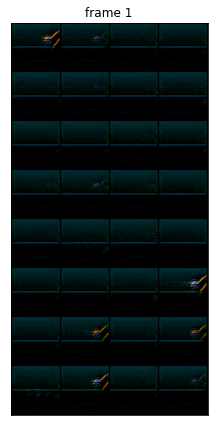

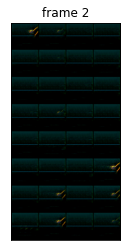

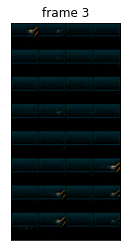

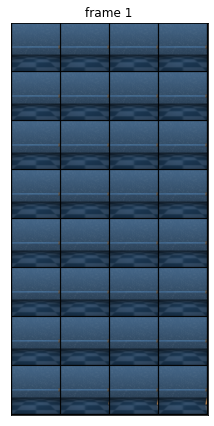

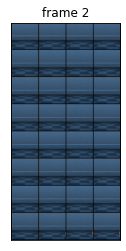

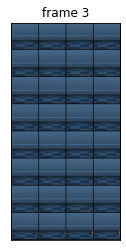

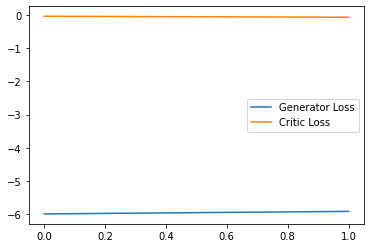

Step 100: Generator loss: -5.734007244110107, critic loss: -0.2786591210477054


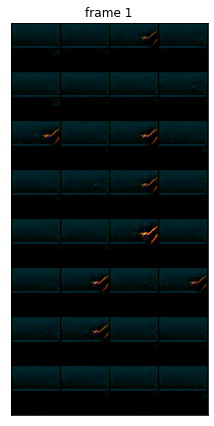

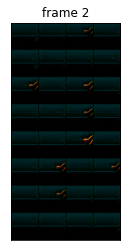

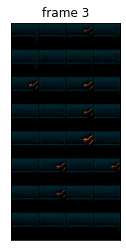

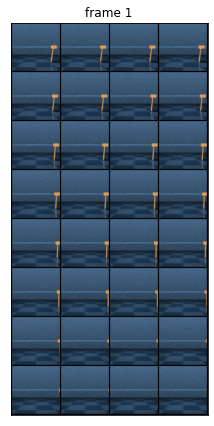

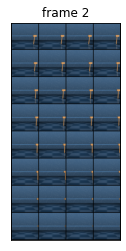

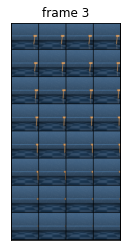

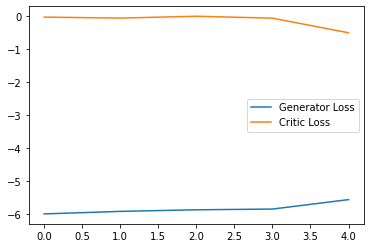

Step 150: Generator loss: -5.863228406906128, critic loss: -0.9150781563371418


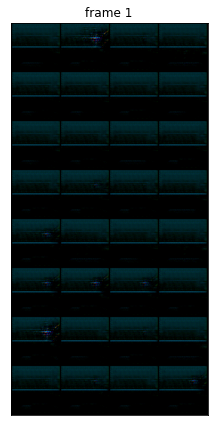

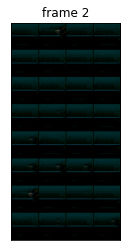

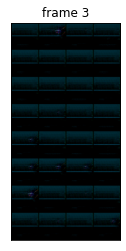

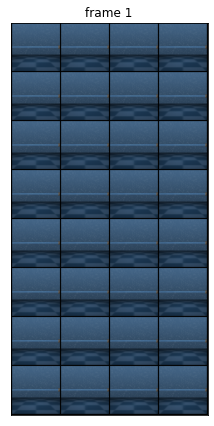

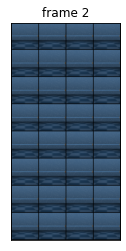

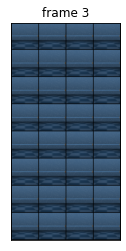

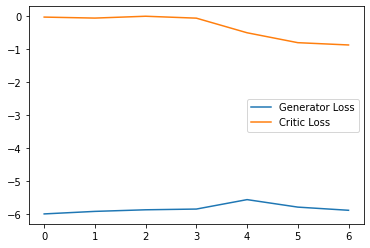

Step 200: Generator loss: -6.142931146621704, critic loss: -0.5449718176648021


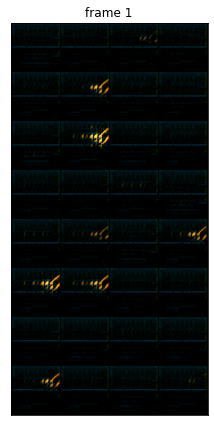

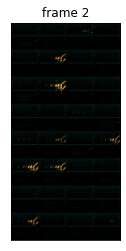

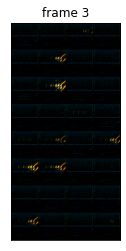

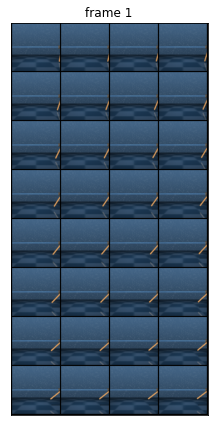

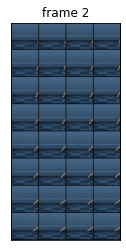

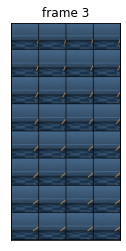

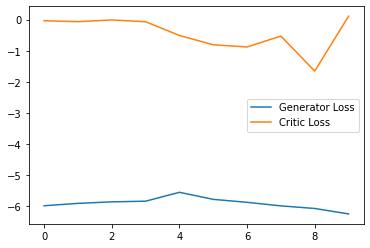

Step 250: Generator loss: -6.249829177856445, critic loss: -0.2316295256316662


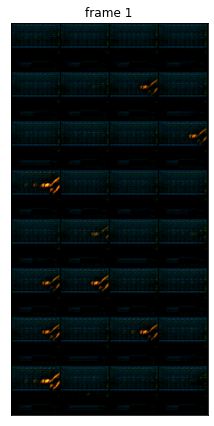

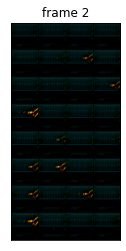

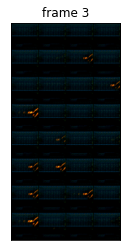

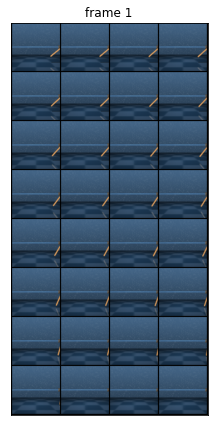

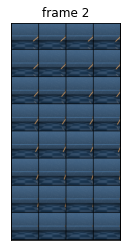

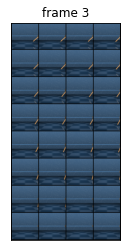

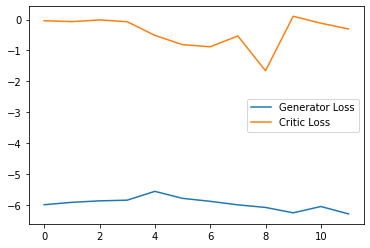

Step 300: Generator loss: -6.601180801391601, critic loss: -0.4183685536980628


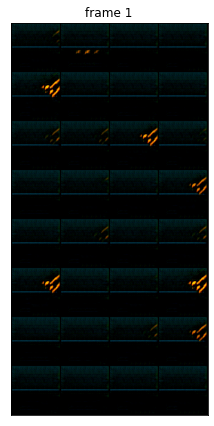

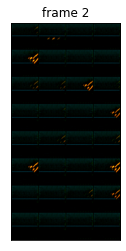

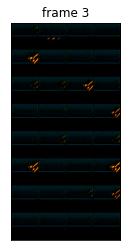

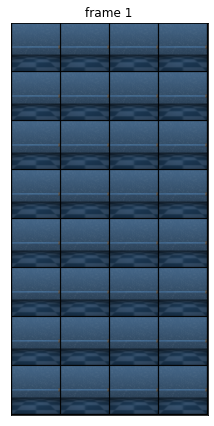

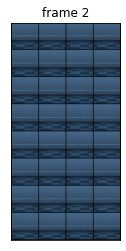

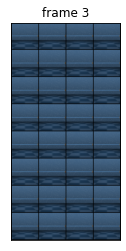

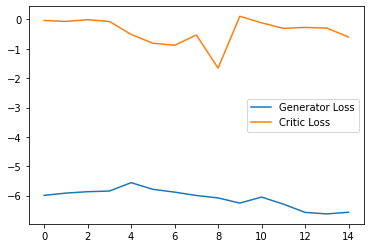

Step 350: Generator loss: -6.485919256210327, critic loss: -0.8961789205670356


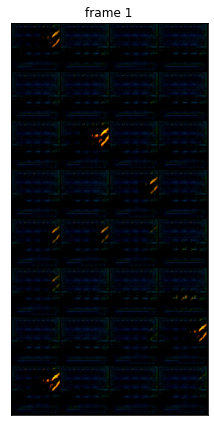

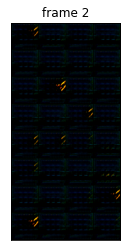

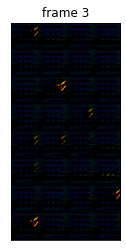

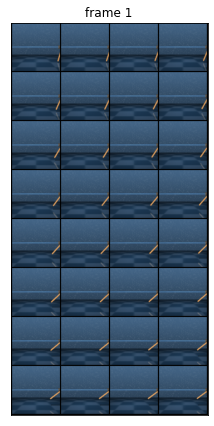

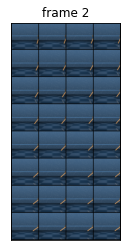

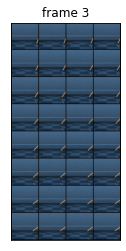

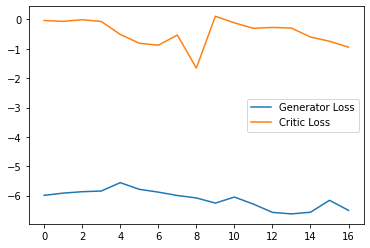

Step 400: Generator loss: -7.565108480453492, critic loss: 0.2133371769934893


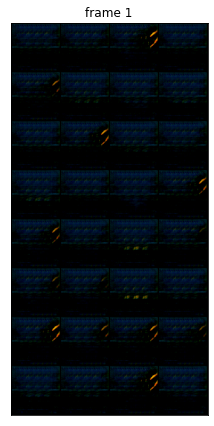

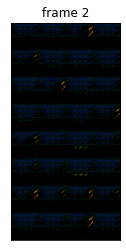

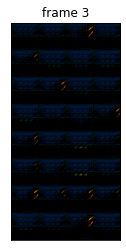

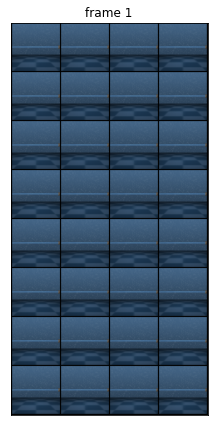

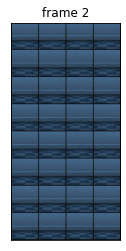

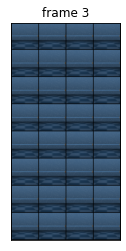

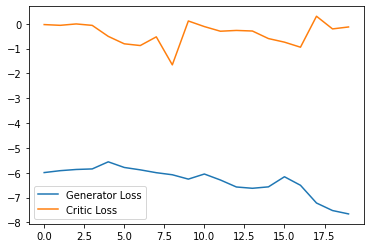

Step 450: Generator loss: -7.682781620025635, critic loss: -0.08324086616188284


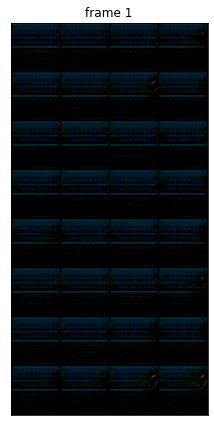

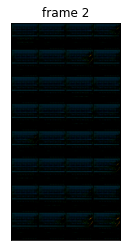

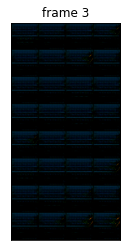

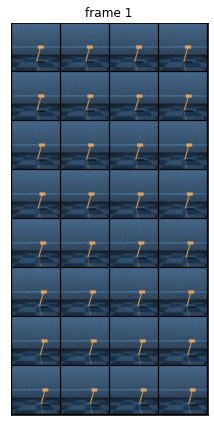

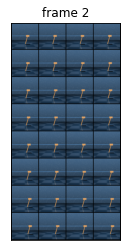

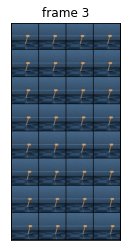

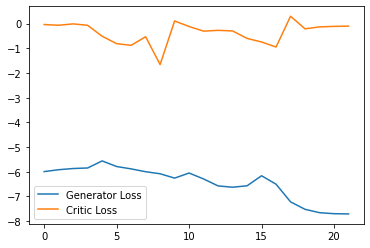

Step 500: Generator loss: -7.493851528167725, critic loss: 0.004775290951132776


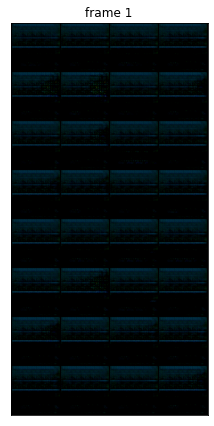

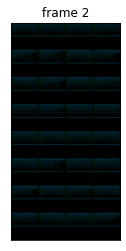

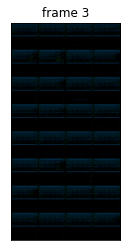

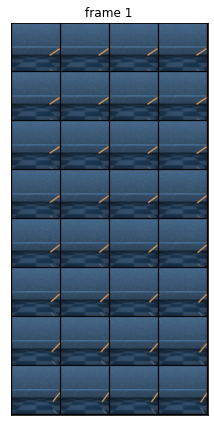

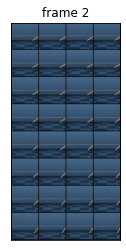

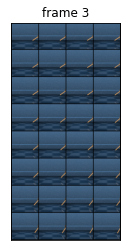

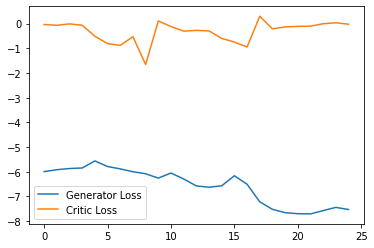

Step 550: Generator loss: -7.601350126266479, critic loss: -0.02065780816227197


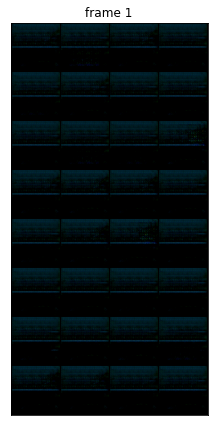

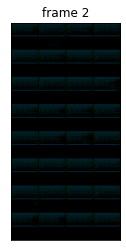

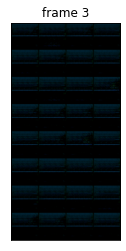

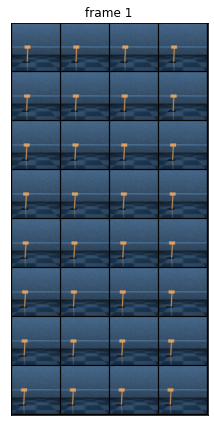

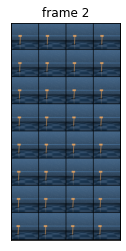

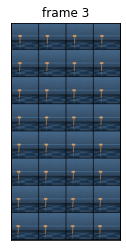

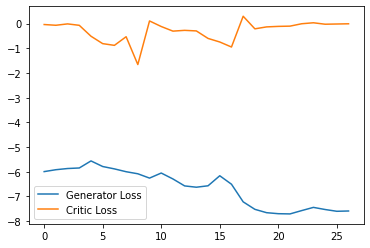

Step 600: Generator loss: -7.46743067741394, critic loss: -0.06915224917978051


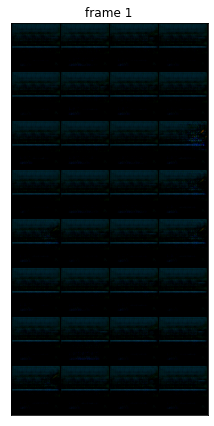

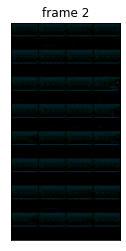

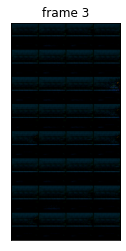

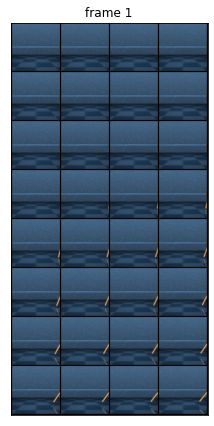

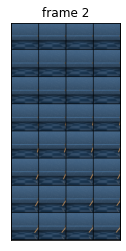

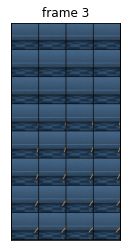

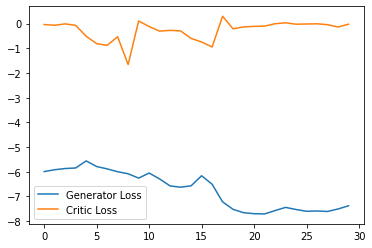

Step 650: Generator loss: -7.460289115905762, critic loss: -0.042070639070123435


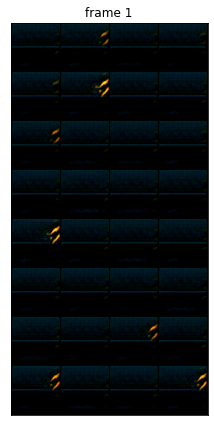

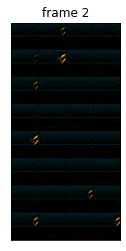

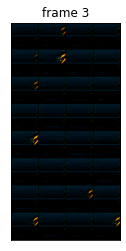

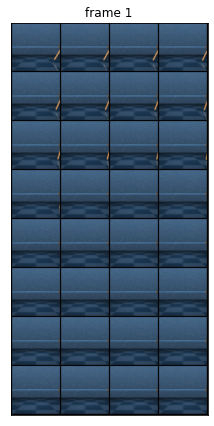

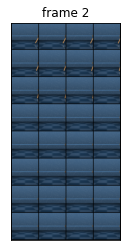

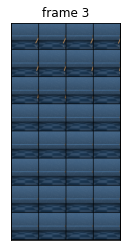

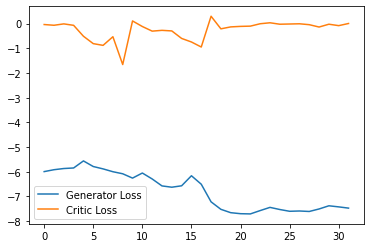

Step 700: Generator loss: -7.52071891784668, critic loss: -0.025421617945656175


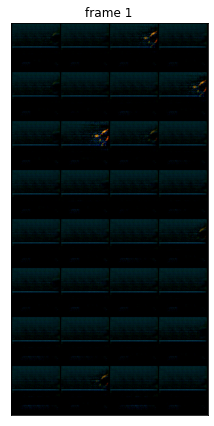

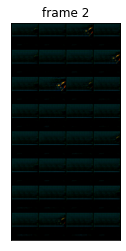

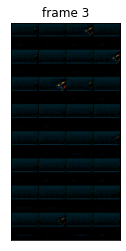

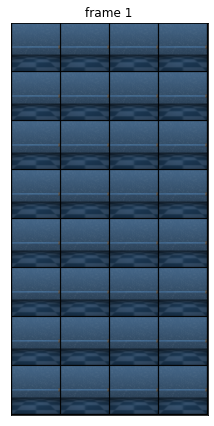

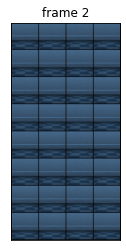

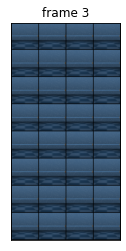

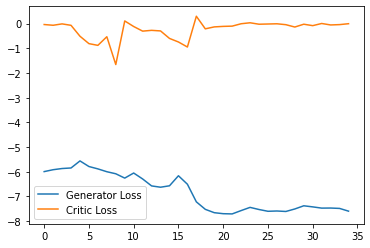

Step 750: Generator loss: -7.5165729904174805, critic loss: -0.05636735160462557


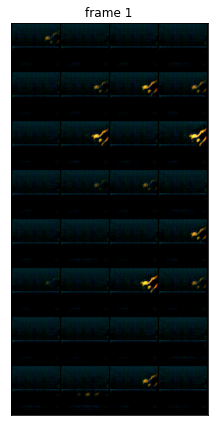

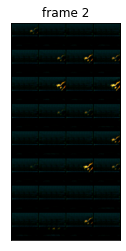

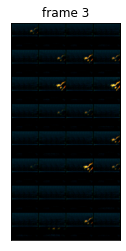

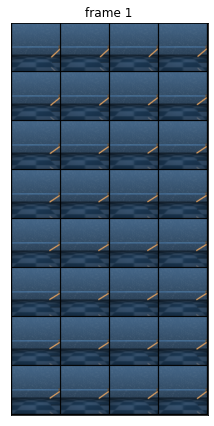

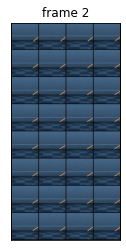

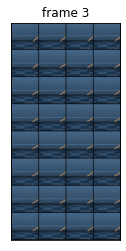

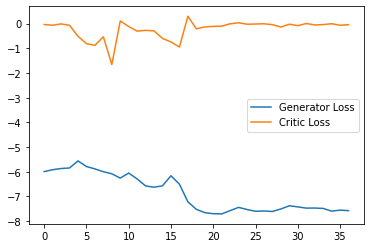

Step 800: Generator loss: -7.549119920730591, critic loss: -0.09066300767660142


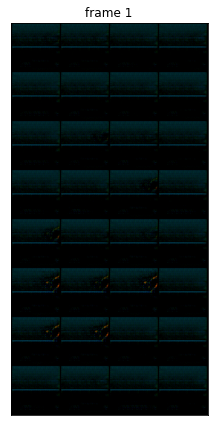

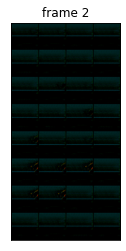

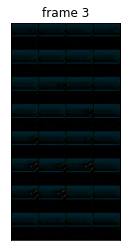

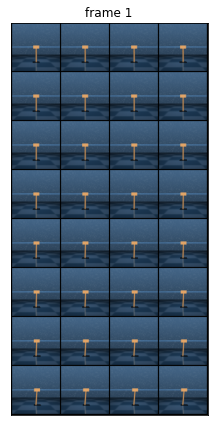

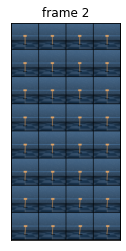

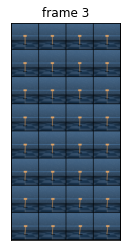

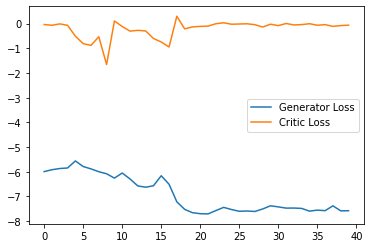

Step 850: Generator loss: -7.468461904525757, critic loss: -0.24748661483079196


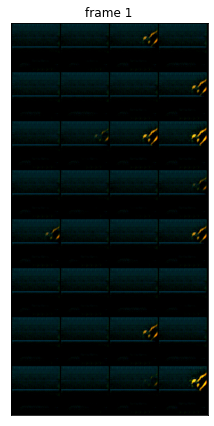

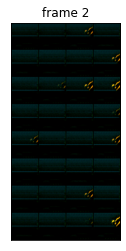

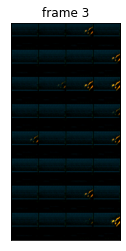

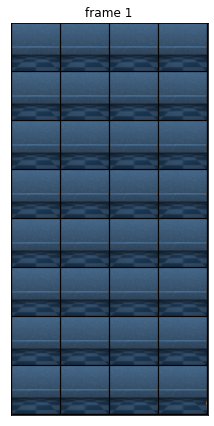

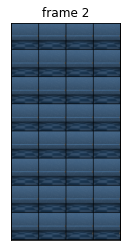

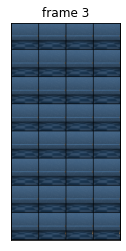

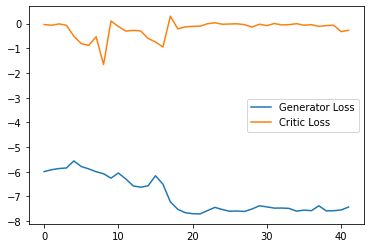

Step 900: Generator loss: -7.448516235351563, critic loss: 0.14826491597294805


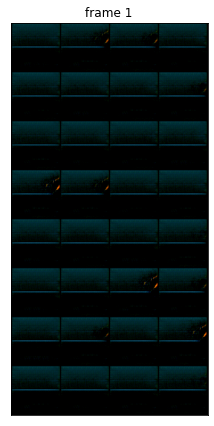

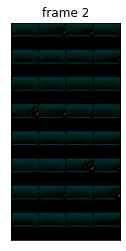

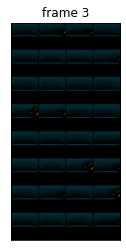

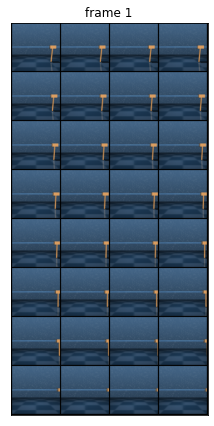

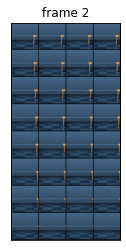

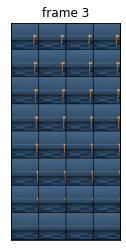

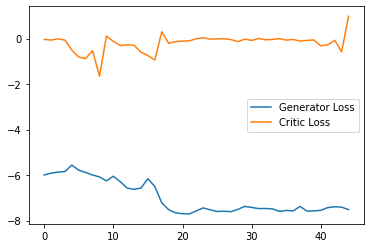

Step 950: Generator loss: -7.346948022842407, critic loss: 0.07241171567514537


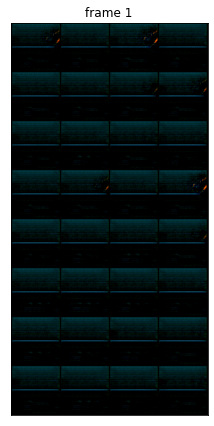

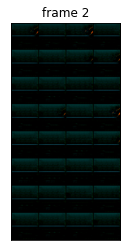

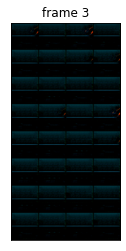

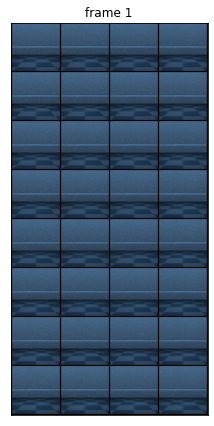

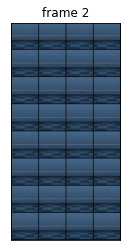

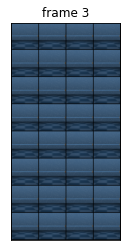

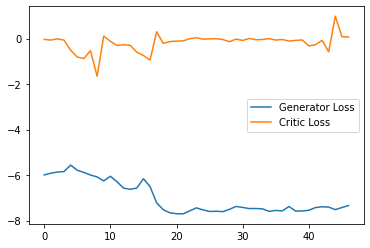

Step 1000: Generator loss: -7.020346279144287, critic loss: -0.005626638244837521


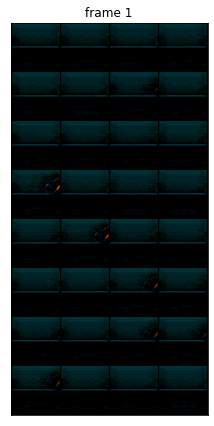

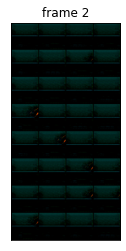

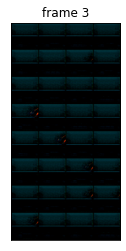

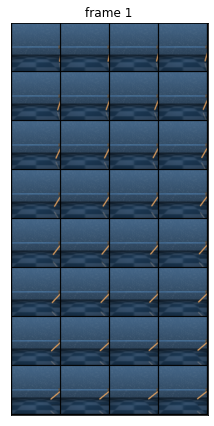

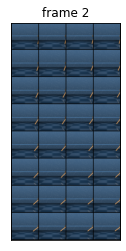

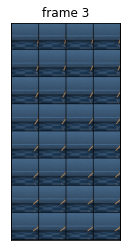

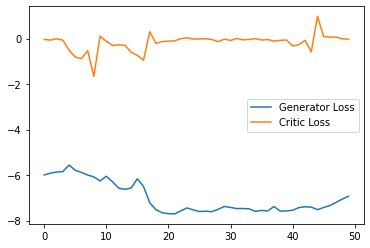

Step 1050: Generator loss: -6.930024185180664, critic loss: -0.03589327816665172


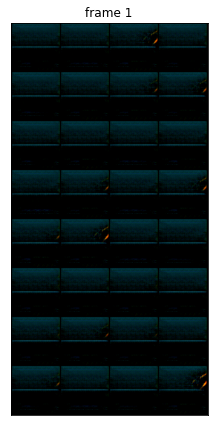

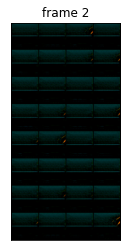

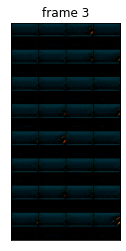

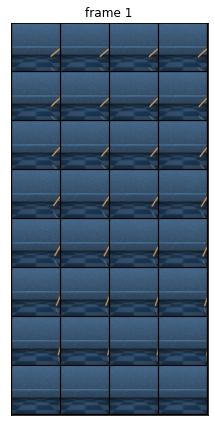

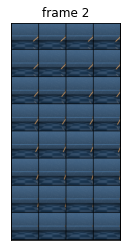

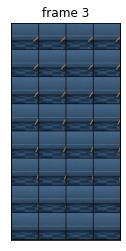

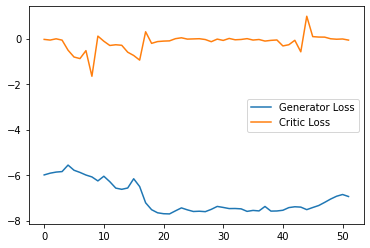

Step 1100: Generator loss: -6.988305940628051, critic loss: -0.03556210603378712


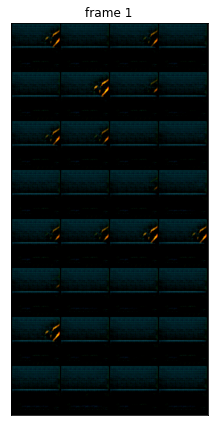

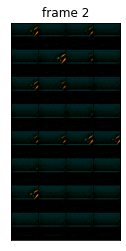

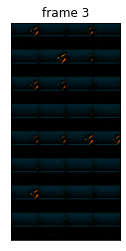

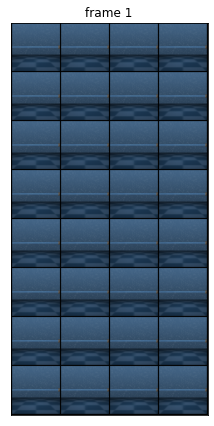

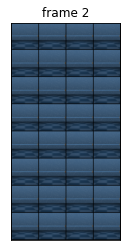

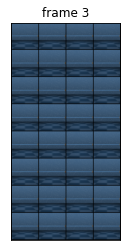

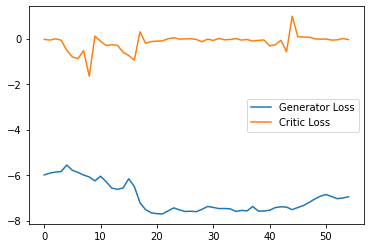

Step 1150: Generator loss: -6.906870450973511, critic loss: -0.016927797056734563


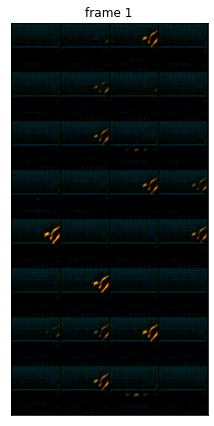

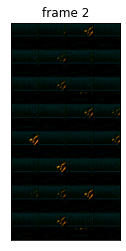

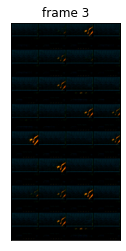

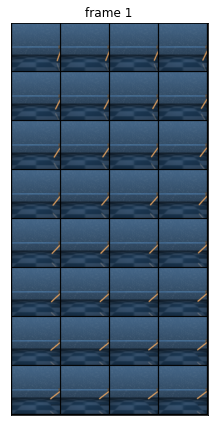

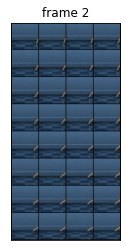

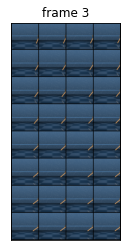

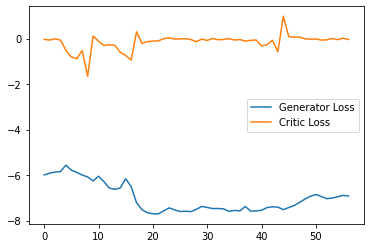

Step 1200: Generator loss: -6.960995483398437, critic loss: -0.07132703093439337


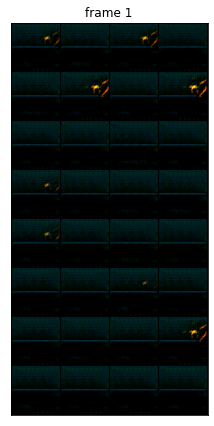

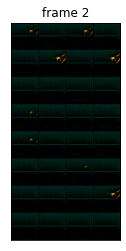

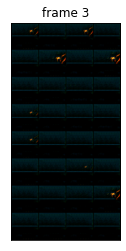

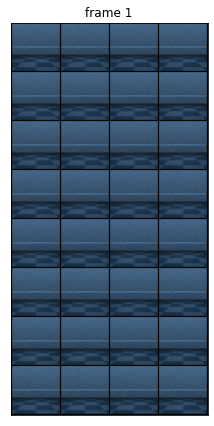

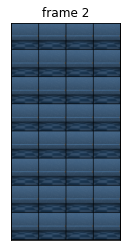

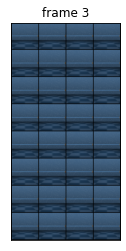

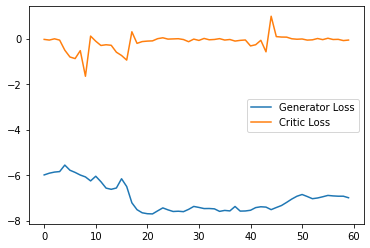

Step 1250: Generator loss: -7.103586072921753, critic loss: -0.02988881747145207


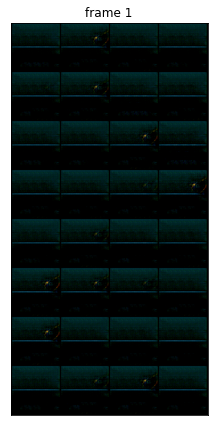

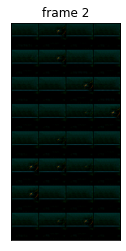

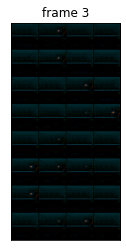

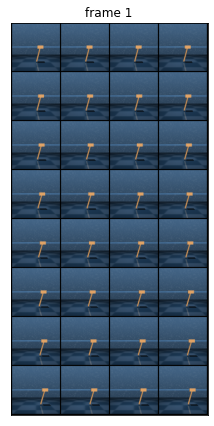

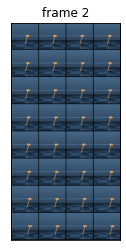

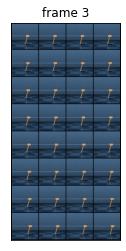

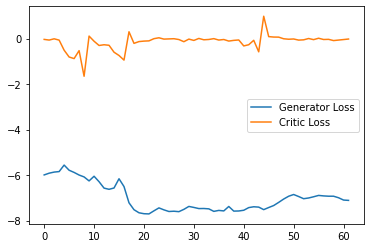

Step 1300: Generator loss: -7.099405126571655, critic loss: -0.04952790497429668


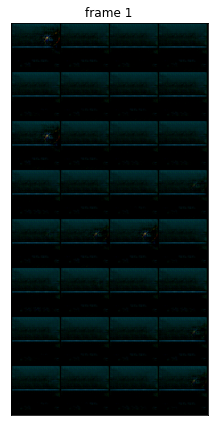

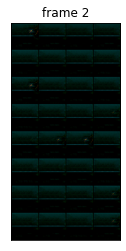

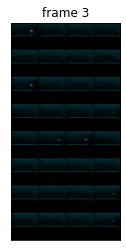

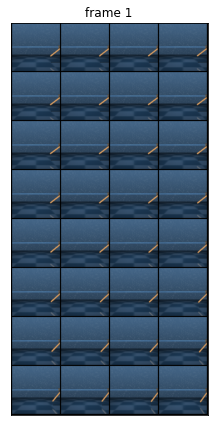

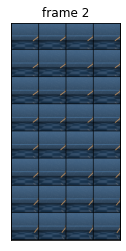

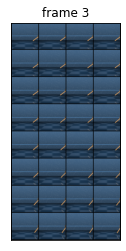

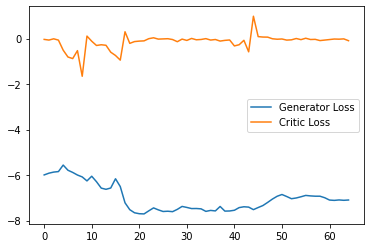

Step 1350: Generator loss: -6.9527285766601565, critic loss: -0.21987280335370454


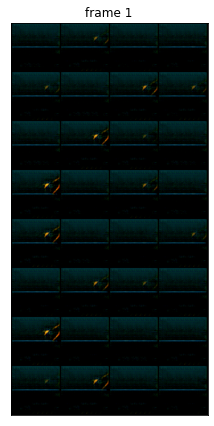

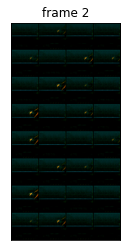

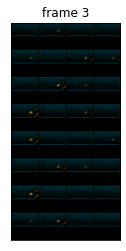

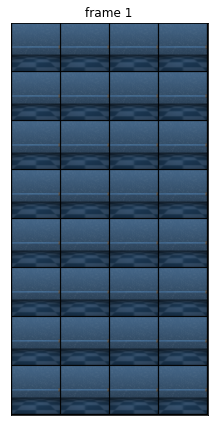

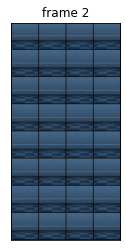

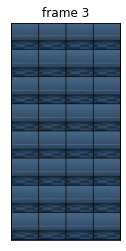

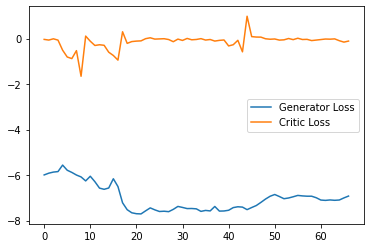

Step 1400: Generator loss: -6.973900146484375, critic loss: -0.05792896128073337


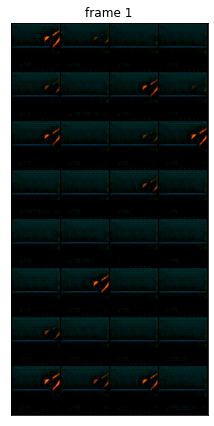

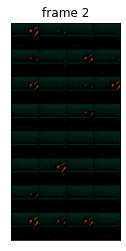

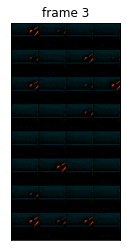

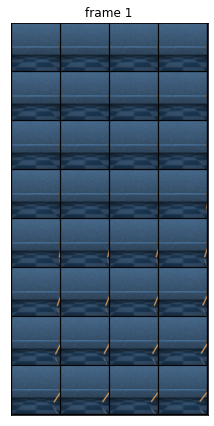

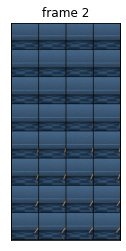

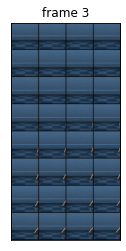

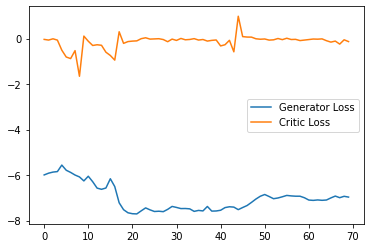

Step 1450: Generator loss: -6.968968238830566, critic loss: -0.26189662612974646


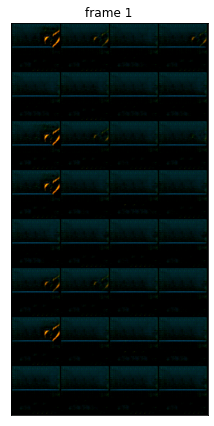

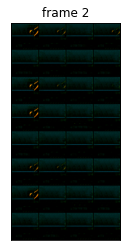

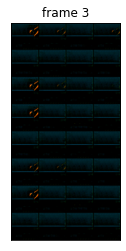

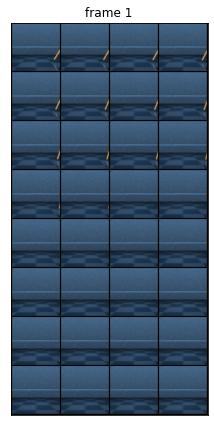

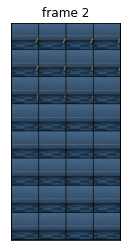

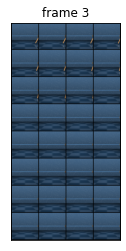

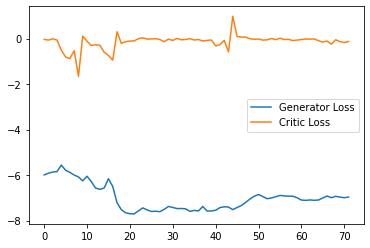

Step 1500: Generator loss: -6.770538425445556, critic loss: -0.3491306567564606


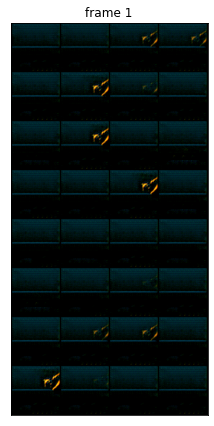

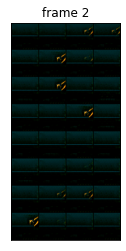

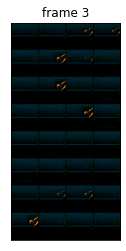

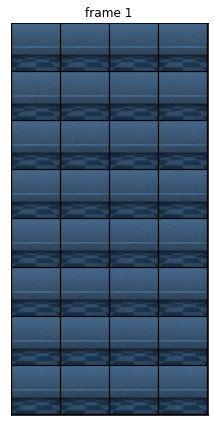

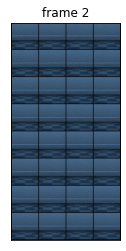

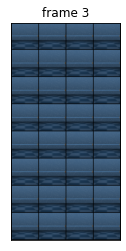

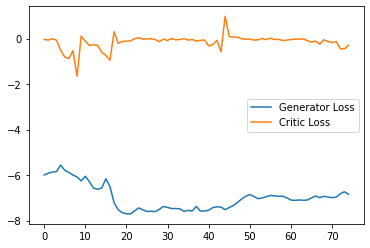

Step 1550: Generator loss: -6.940697355270386, critic loss: -0.9016722434163094


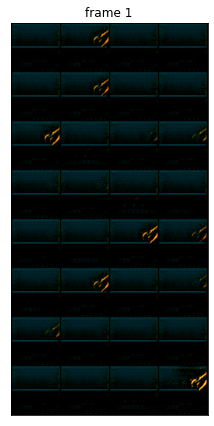

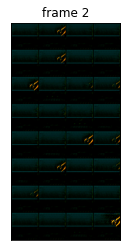

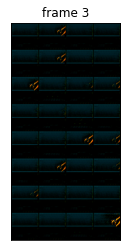

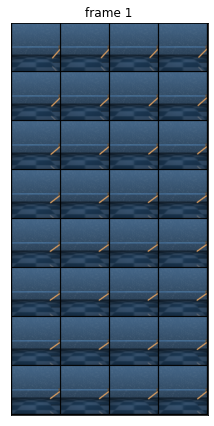

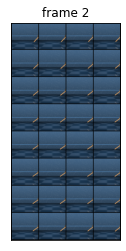

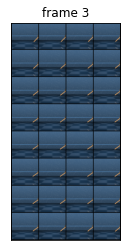

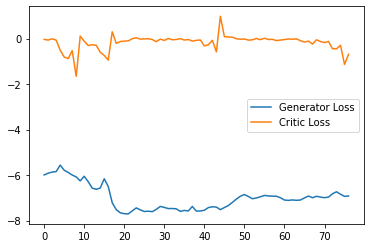

Step 1600: Generator loss: -7.182707166671753, critic loss: -0.8288071953356265


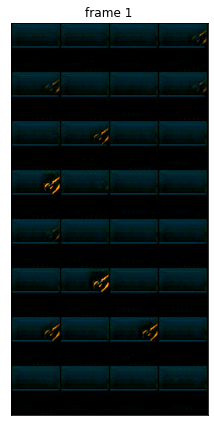

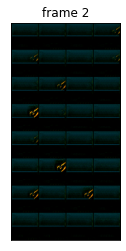

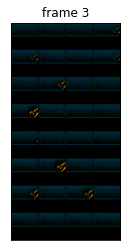

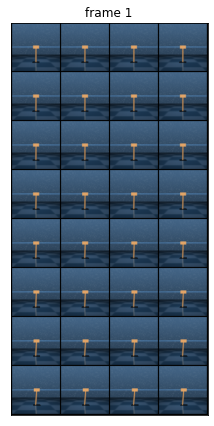

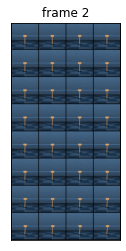

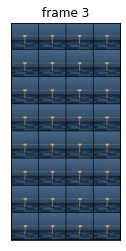

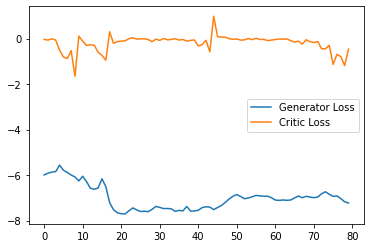

Step 1650: Generator loss: -7.4092636394500735, critic loss: -1.3129975876063107


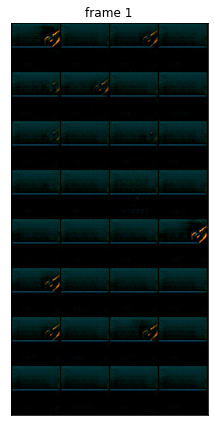

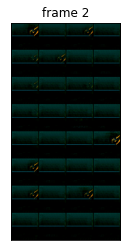

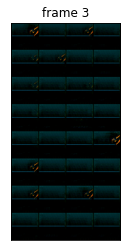

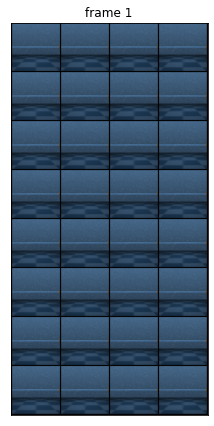

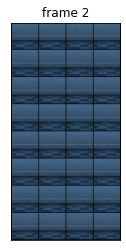

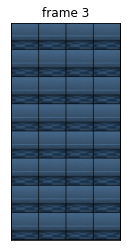

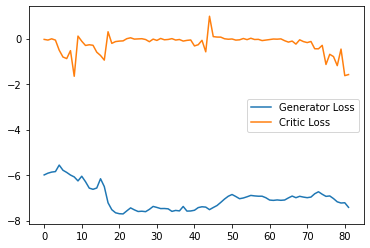

Step 1700: Generator loss: -7.8522255325317385, critic loss: -1.9509228042438624


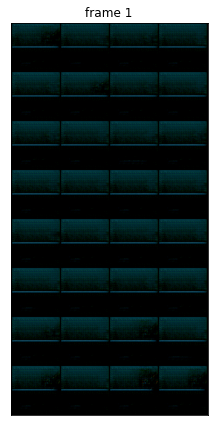

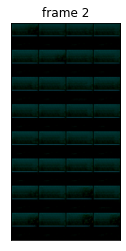

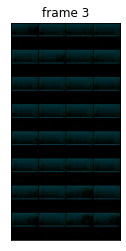

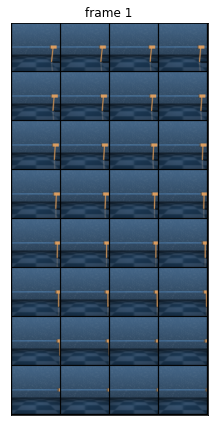

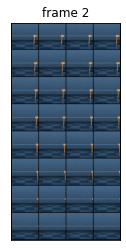

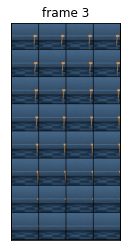

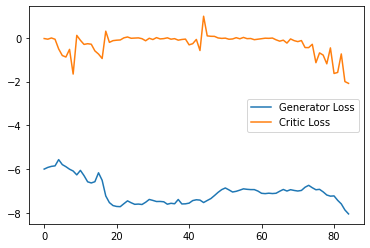

Step 1750: Generator loss: -8.149741725921631, critic loss: 0.5080929126031701


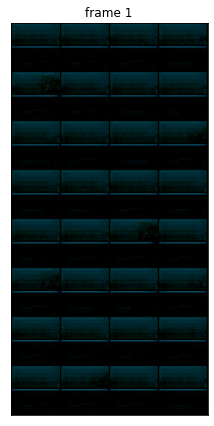

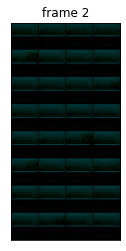

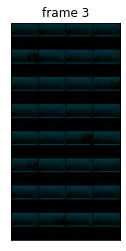

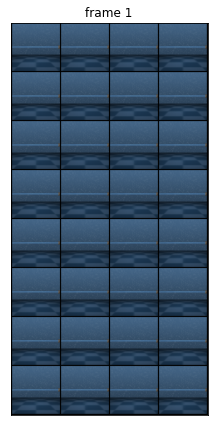

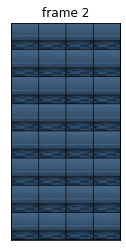

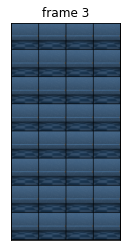

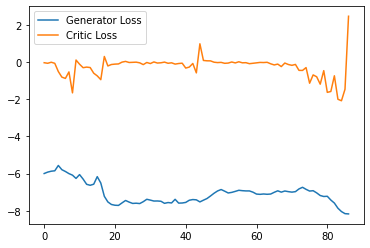

Step 1800: Generator loss: -8.23560583114624, critic loss: 0.0519300068318844


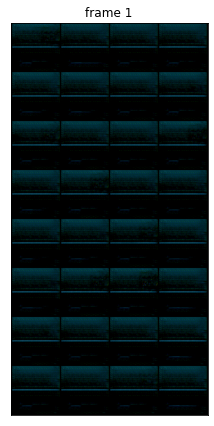

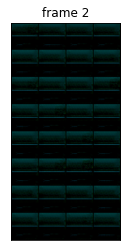

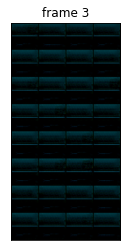

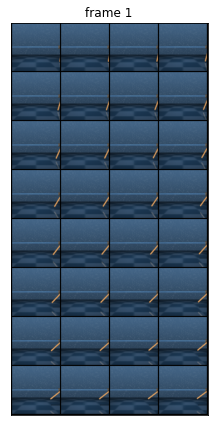

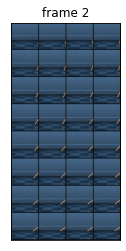

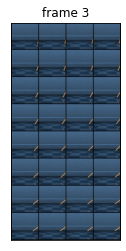

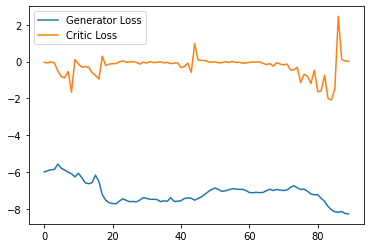

Step 1850: Generator loss: -8.192507762908935, critic loss: 0.00762299176491797


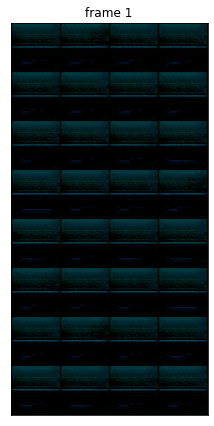

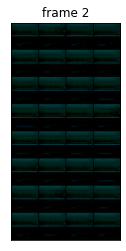

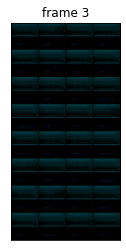

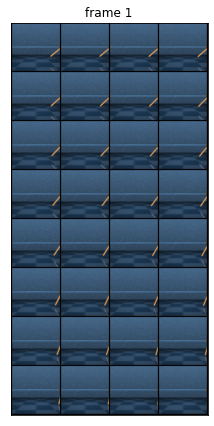

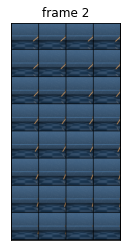

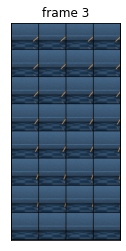

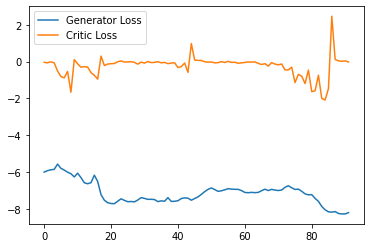

Step 1900: Generator loss: -7.986018476486206, critic loss: -0.06082547649741172


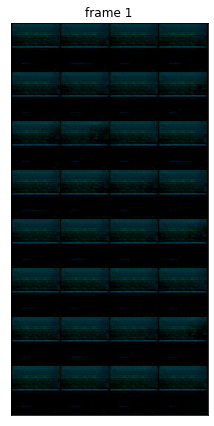

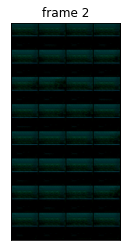

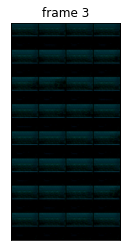

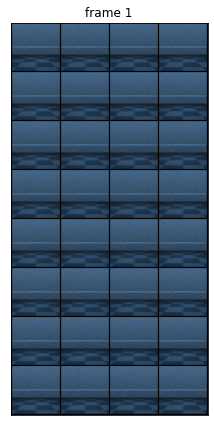

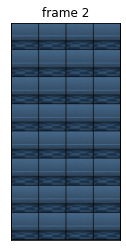

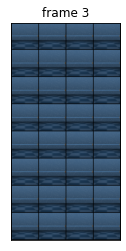

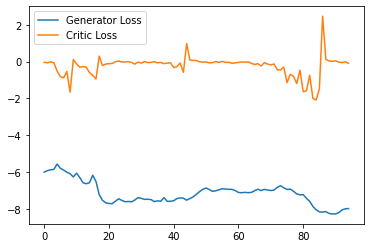

Step 1950: Generator loss: -7.950428609848022, critic loss: -0.06646779170259835


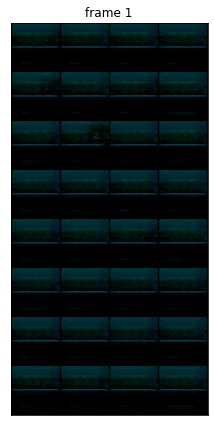

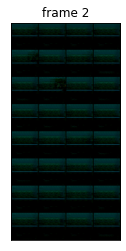

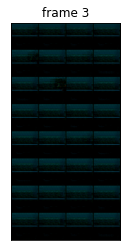

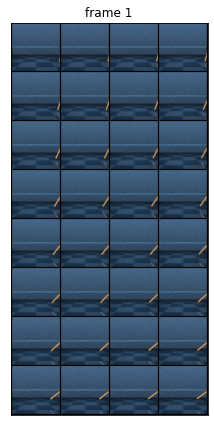

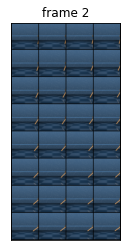

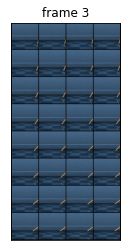

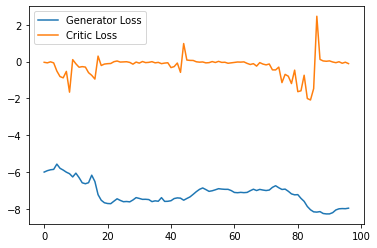

Step 2000: Generator loss: -7.8636507797241215, critic loss: -0.12294553447980436


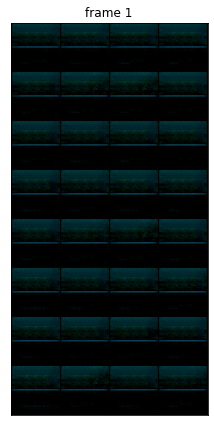

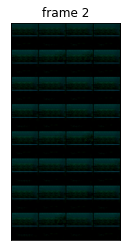

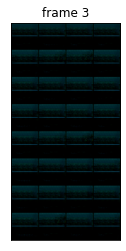

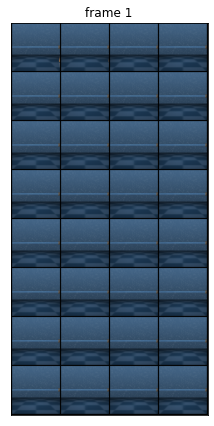

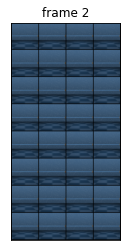

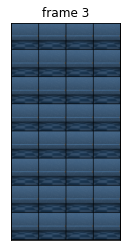

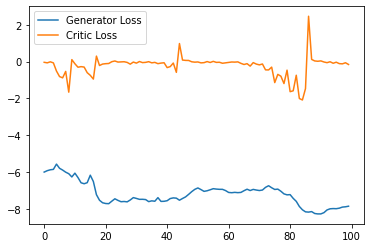

Step 2050: Generator loss: -7.810782613754273, critic loss: -0.1483603933090344


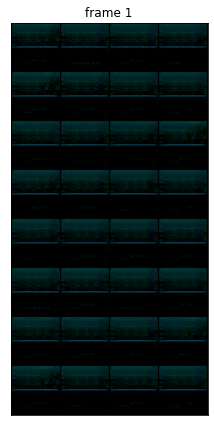

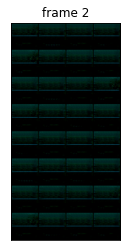

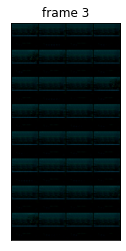

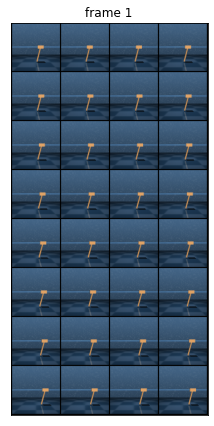

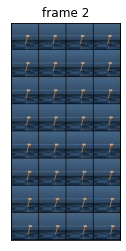

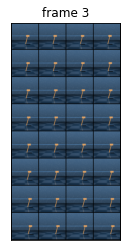

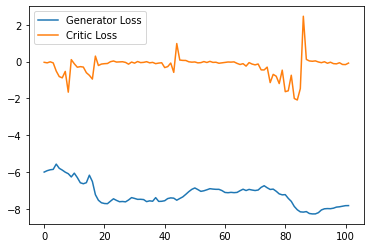

Step 2100: Generator loss: -7.898314094543457, critic loss: -0.1627243459792808


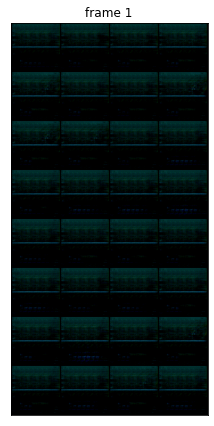

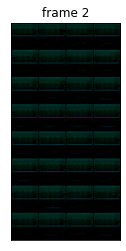

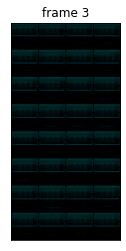

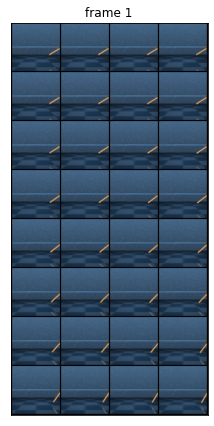

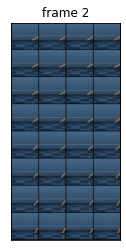

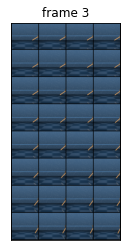

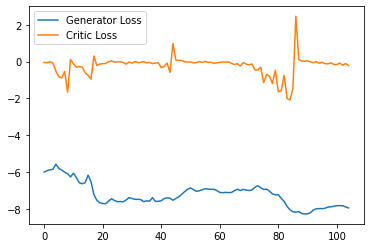

Step 2150: Generator loss: -7.948359642028809, critic loss: -0.1987983683152124


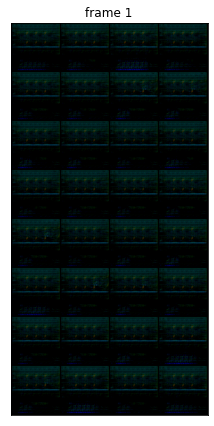

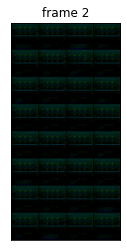

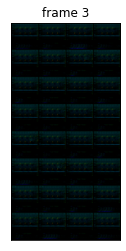

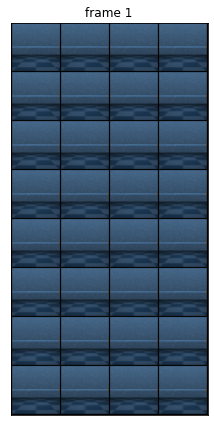

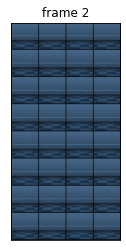

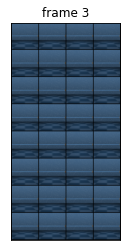

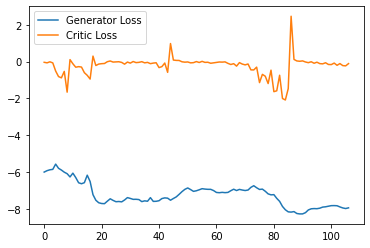

Step 2200: Generator loss: -8.073629837036133, critic loss: 0.04505126030370591


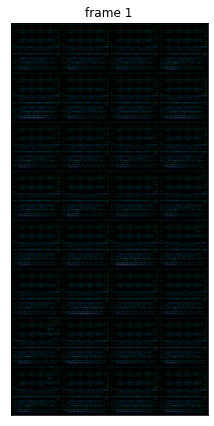

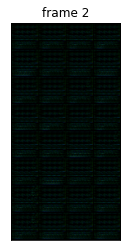

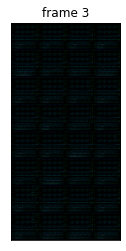

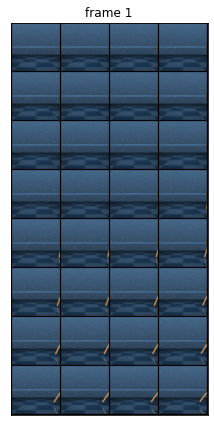

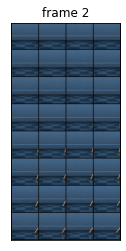

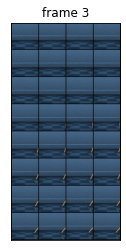

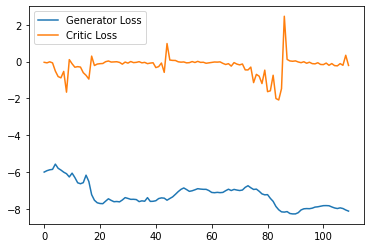

Step 2250: Generator loss: -8.504436092376709, critic loss: -0.301274931460619


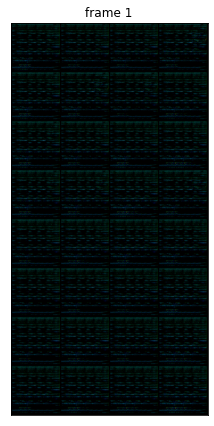

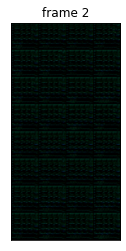

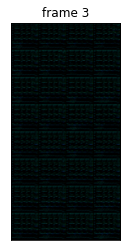

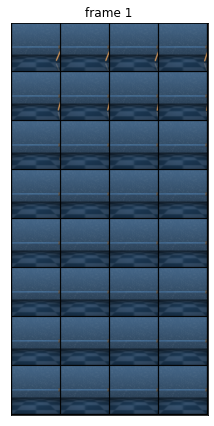

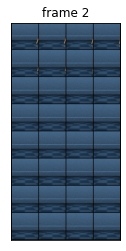

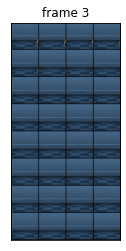

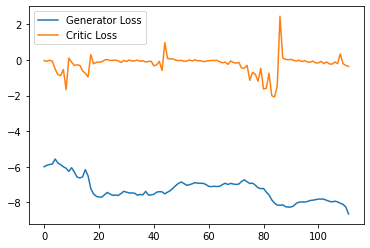

Step 2300: Generator loss: -8.71590078353882, critic loss: -0.21369796690344814


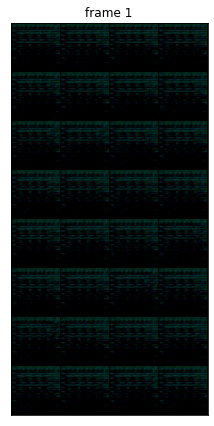

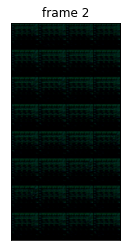

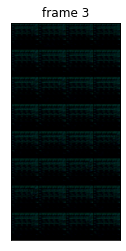

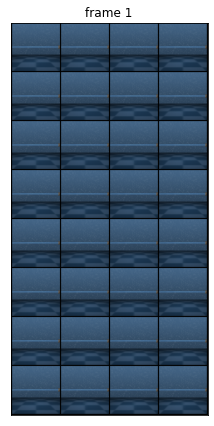

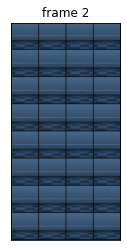

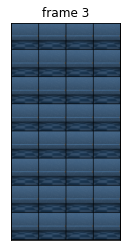

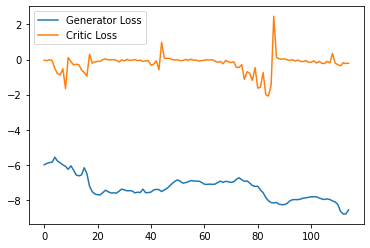

Step 2350: Generator loss: -8.344743156433106, critic loss: -0.12325767853856086


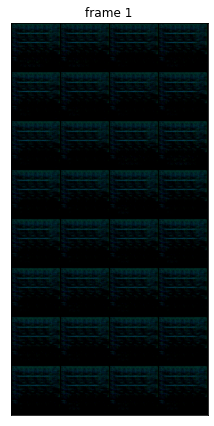

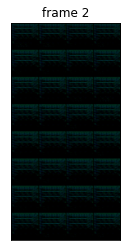

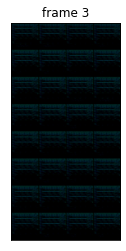

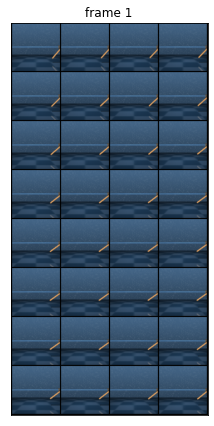

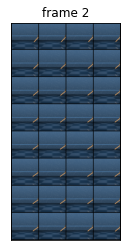

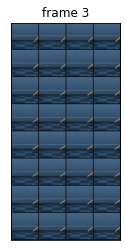

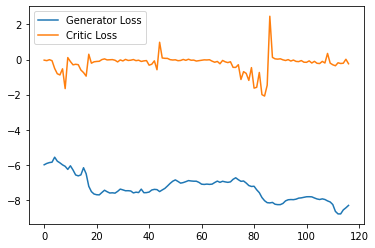

Step 2400: Generator loss: -8.290187168121339, critic loss: -0.11717873595654967


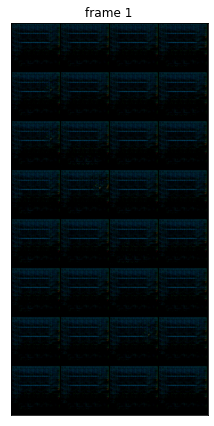

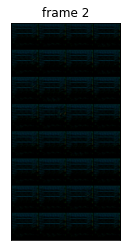

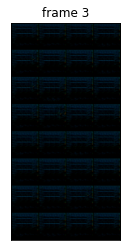

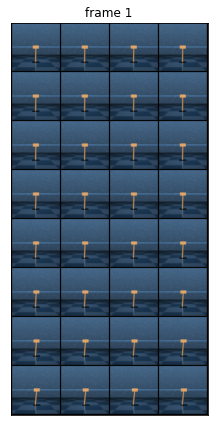

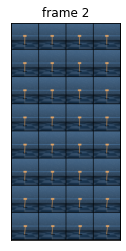

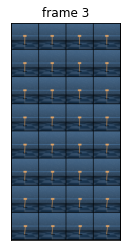

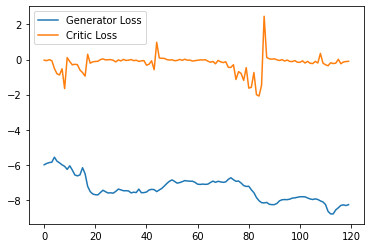

Step 2450: Generator loss: -8.168248558044434, critic loss: -0.1287106669098139


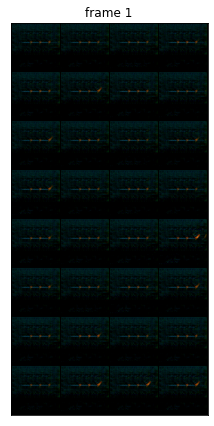

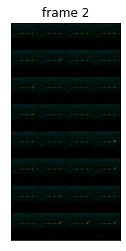

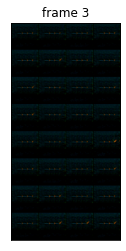

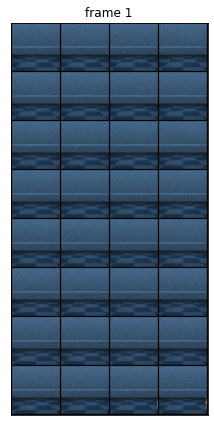

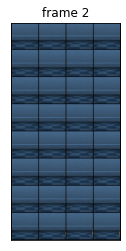

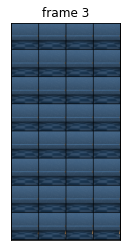

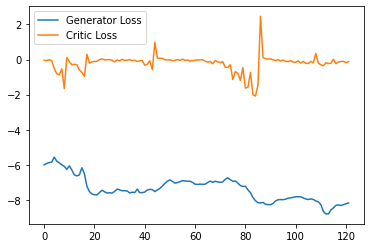

Step 2500: Generator loss: -8.256532230377196, critic loss: -0.22330311304517092


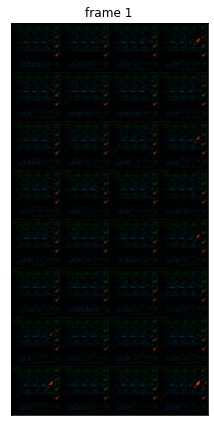

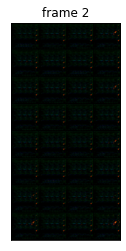

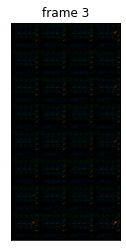

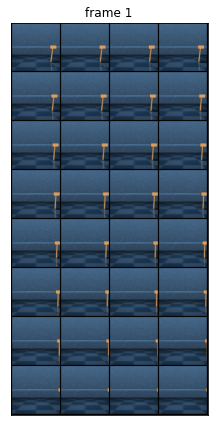

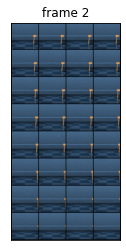

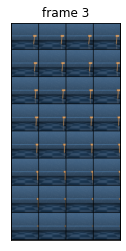

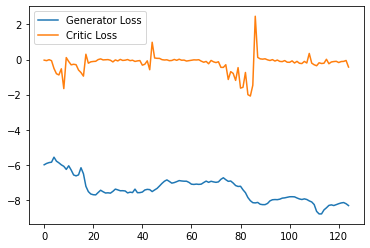

Step 2550: Generator loss: -8.842846279144288, critic loss: -0.2928020036518574


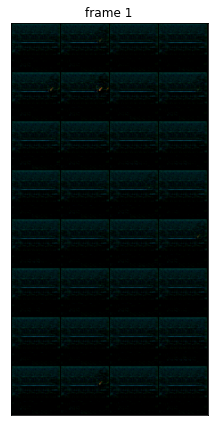

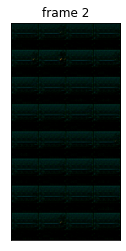

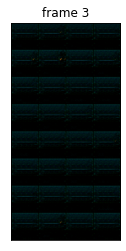

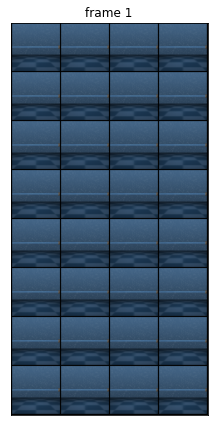

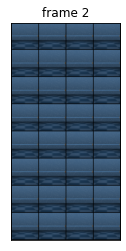

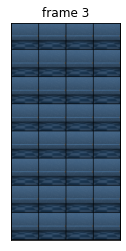

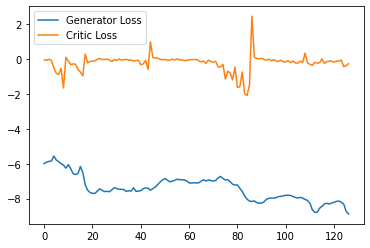

Step 2600: Generator loss: -8.761735229492187, critic loss: -0.16791484103724363


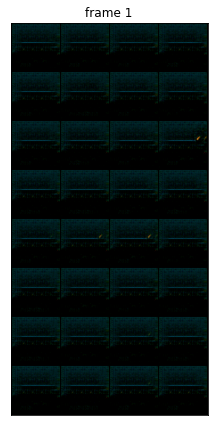

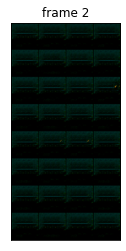

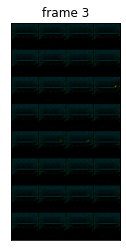

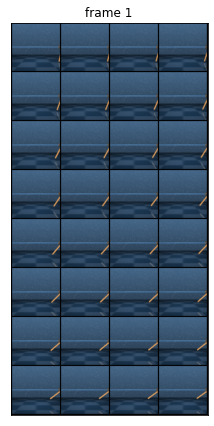

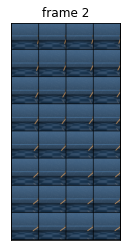

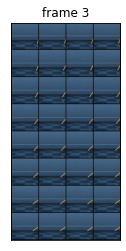

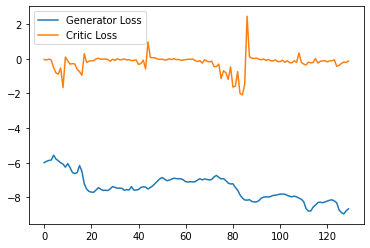

Step 2650: Generator loss: -8.711963691711425, critic loss: -0.10592279180139302


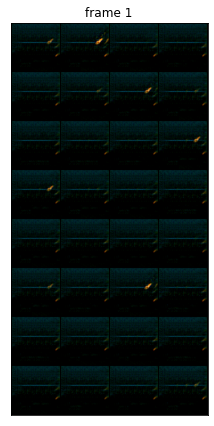

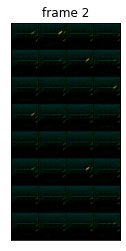

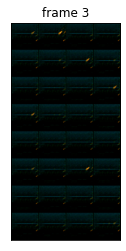

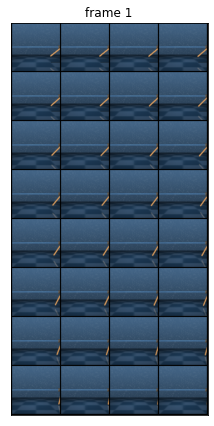

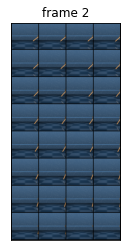

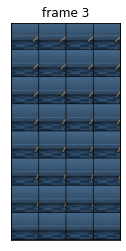

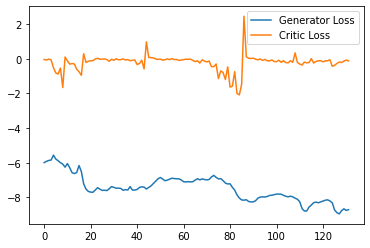

Step 2700: Generator loss: -8.585476913452148, critic loss: -0.1620829239711165


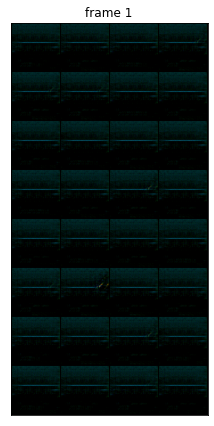

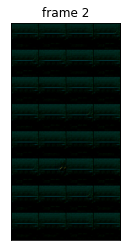

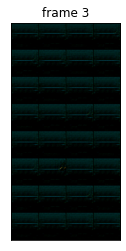

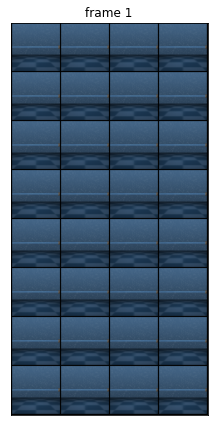

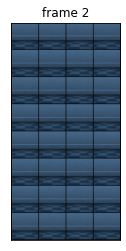

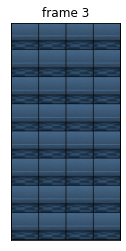

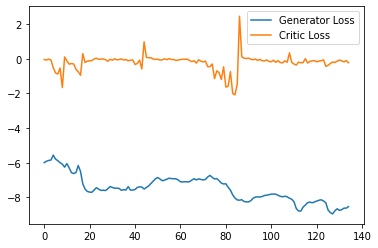

Step 2750: Generator loss: -8.495736179351807, critic loss: -0.21197799621894958


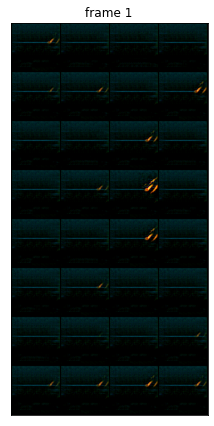

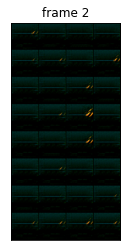

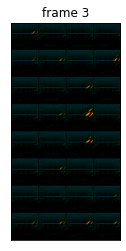

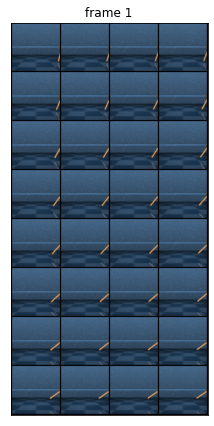

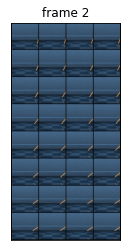

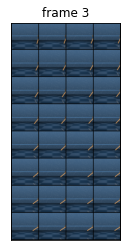

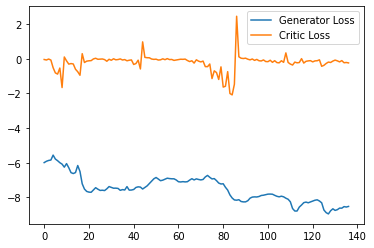

Step 2800: Generator loss: -7.988517274856568, critic loss: -0.17883382914215318


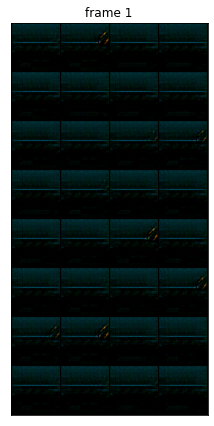

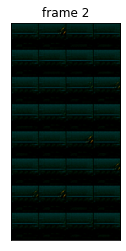

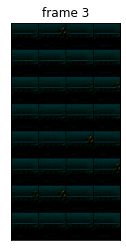

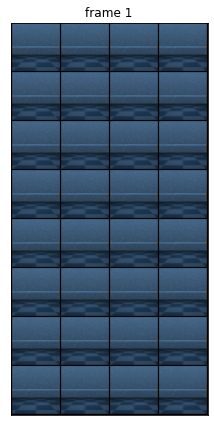

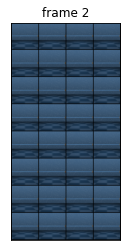

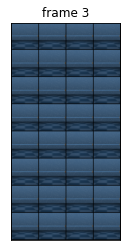

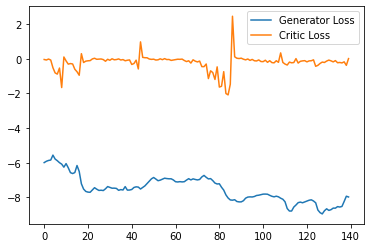

Step 2850: Generator loss: -8.137312154769898, critic loss: -0.16724357968941336


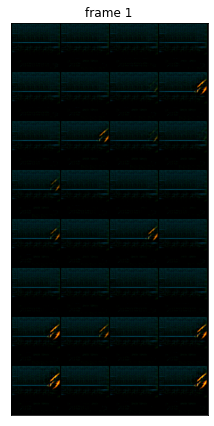

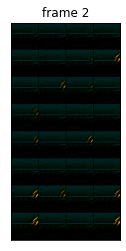

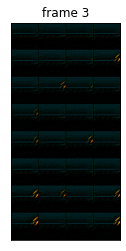

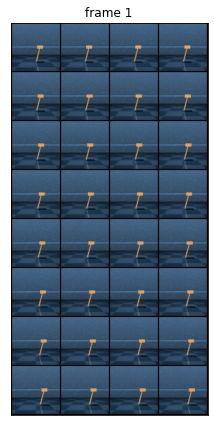

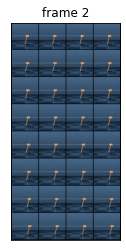

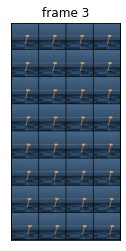

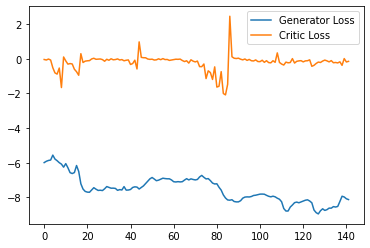

Step 2900: Generator loss: -7.945422506332397, critic loss: -0.24016606925427916


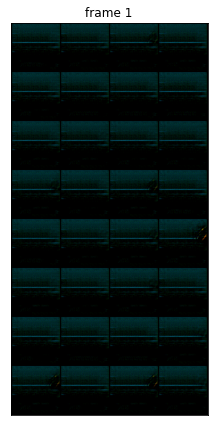

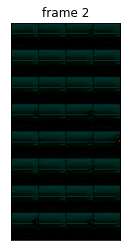

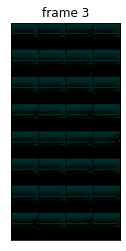

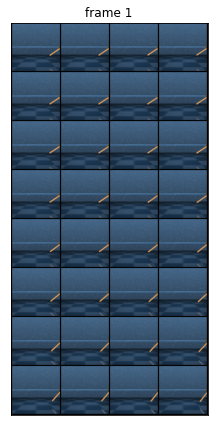

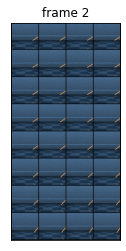

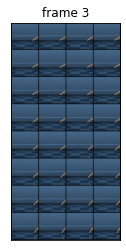

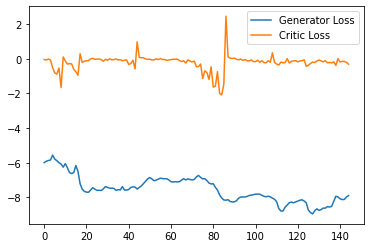

Step 2950: Generator loss: -7.877080554962158, critic loss: -0.23034343451634057


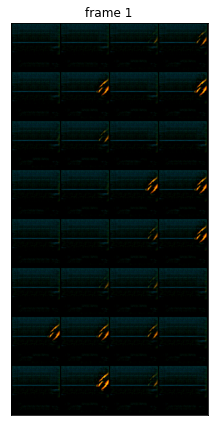

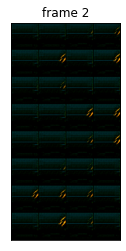

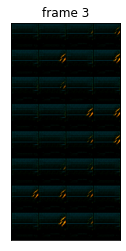

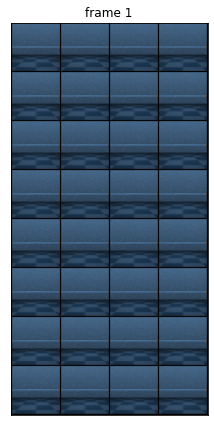

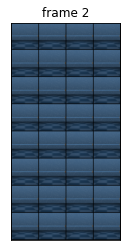

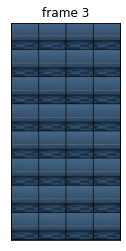

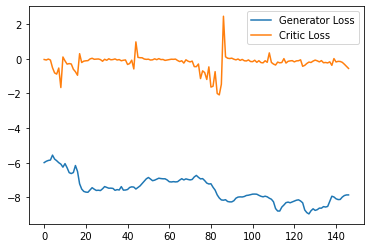

Step 3000: Generator loss: -7.730912961959839, critic loss: -0.1902993816137314


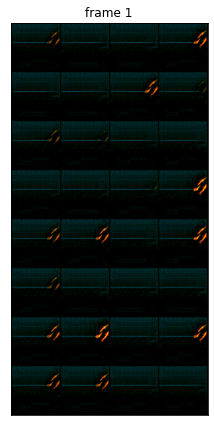

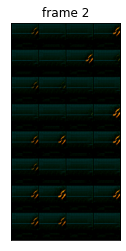

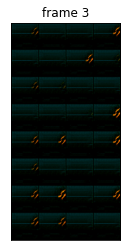

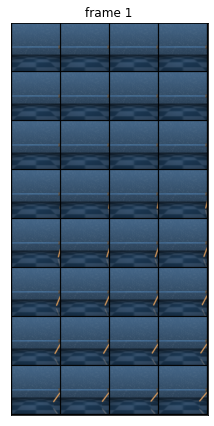

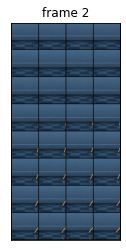

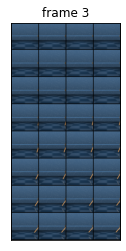

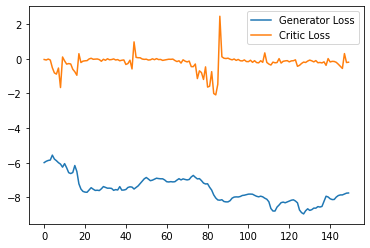

Step 3050: Generator loss: -7.7177324295043945, critic loss: -0.8542555486261847


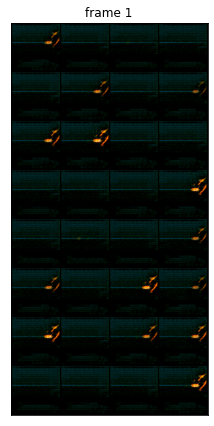

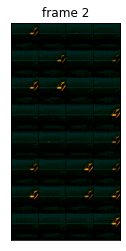

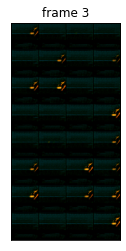

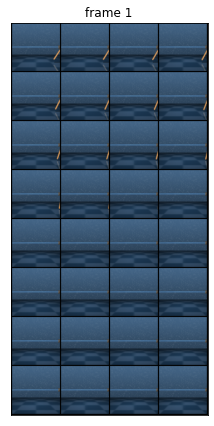

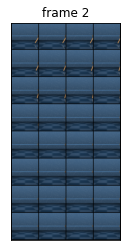

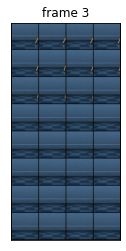

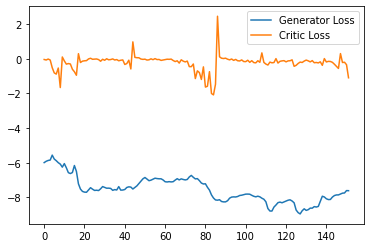

Step 3100: Generator loss: -8.537048244476319, critic loss: -0.6623764044791458


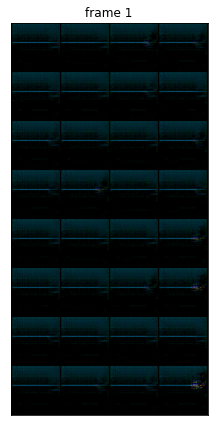

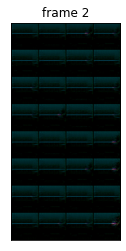

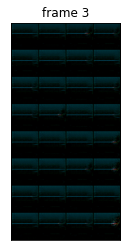

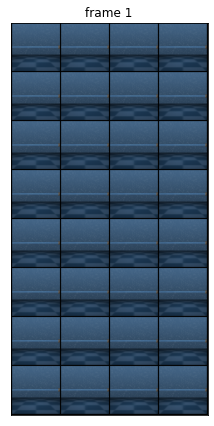

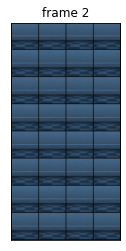

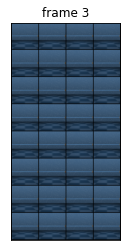

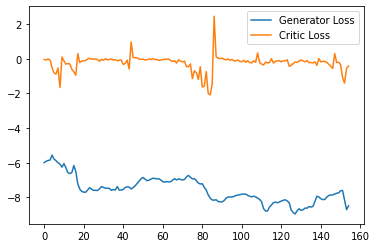

Step 3150: Generator loss: -8.049275312423706, critic loss: -0.5892036746069789


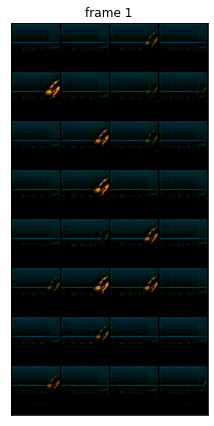

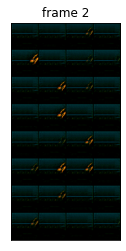

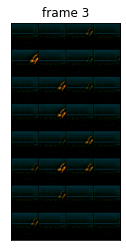

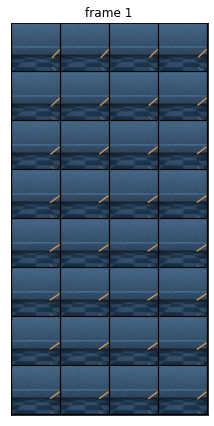

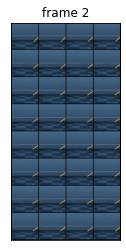

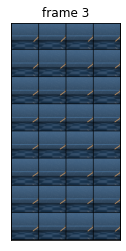

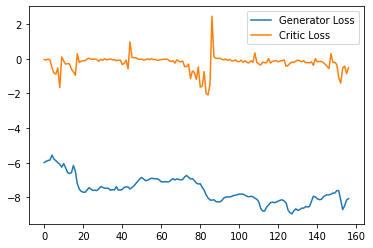

Step 3200: Generator loss: -8.033097734451294, critic loss: -0.8291095025986432


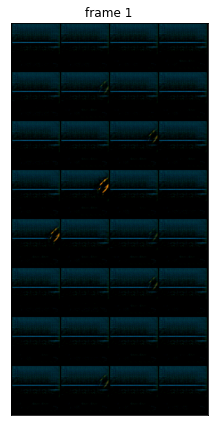

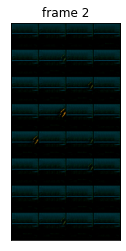

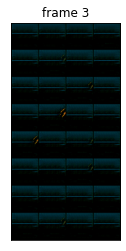

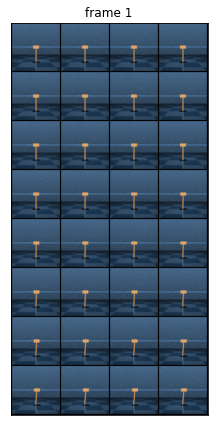

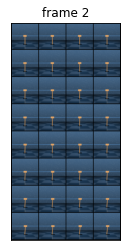

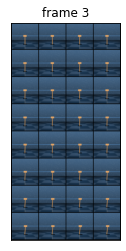

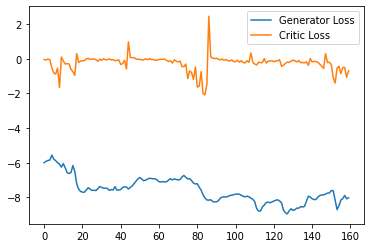

Step 3250: Generator loss: -8.089062900543214, critic loss: -1.2336016389466822


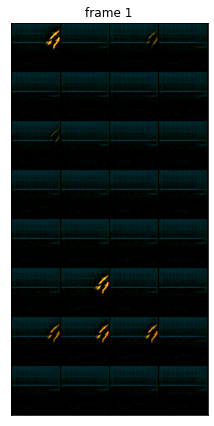

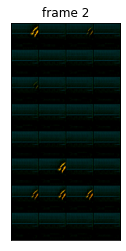

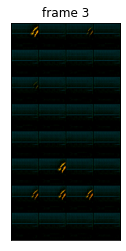

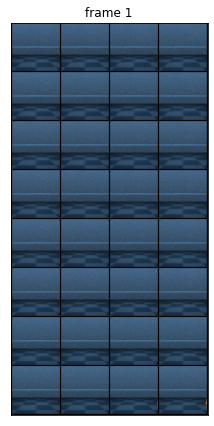

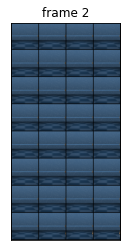

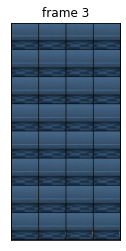

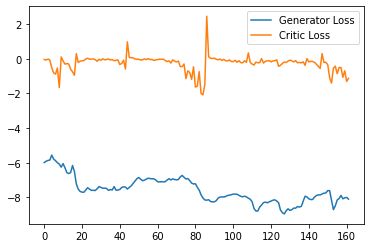

Step 3300: Generator loss: -8.116386013031006, critic loss: -1.5074938375055793


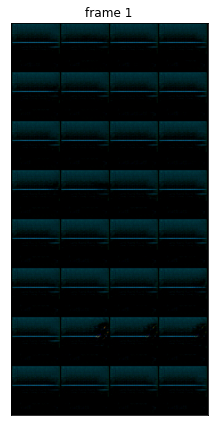

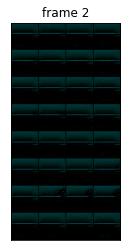

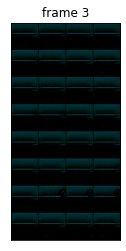

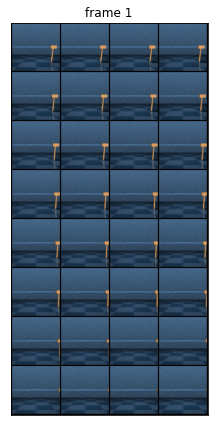

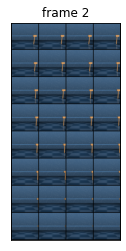

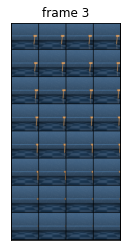

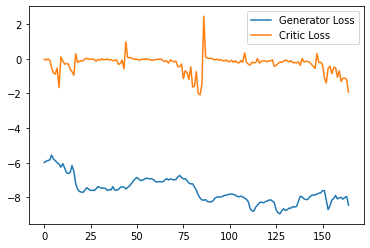

Step 3350: Generator loss: -7.796156311035157, critic loss: -2.1965161567106843


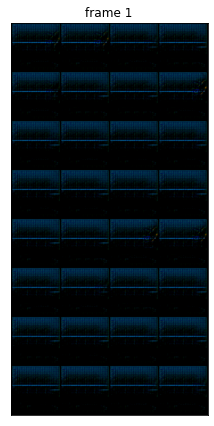

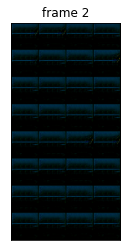

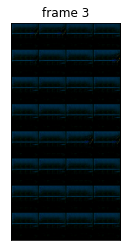

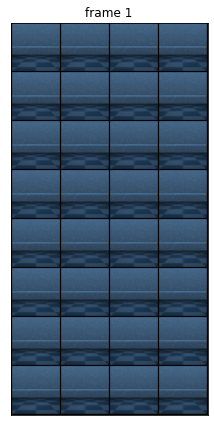

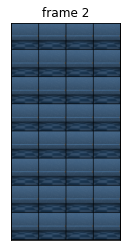

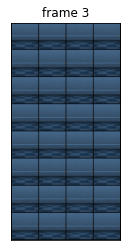

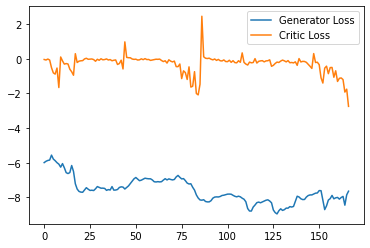

Step 3400: Generator loss: -7.57927303314209, critic loss: -0.013287410274148138


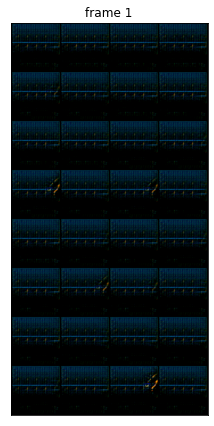

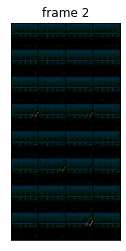

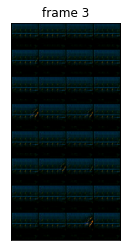

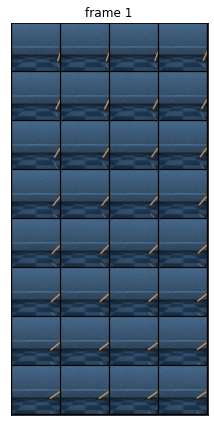

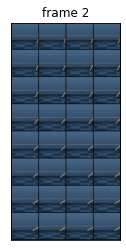

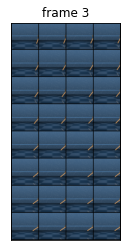

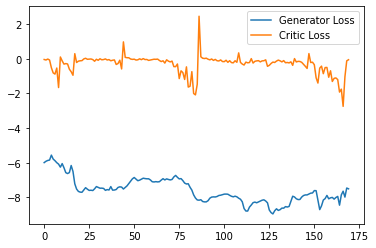

Step 3450: Generator loss: -7.750012855529786, critic loss: -0.09775270277261734


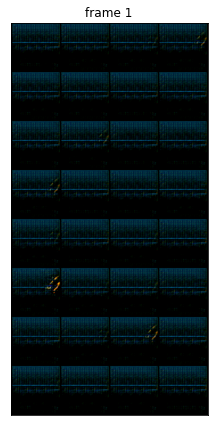

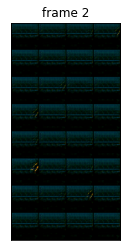

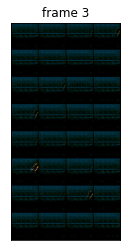

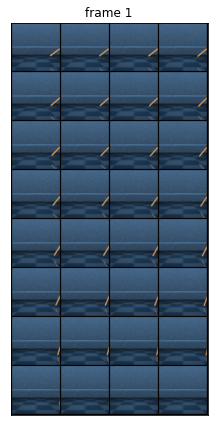

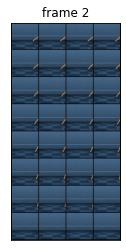

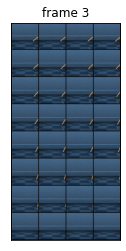

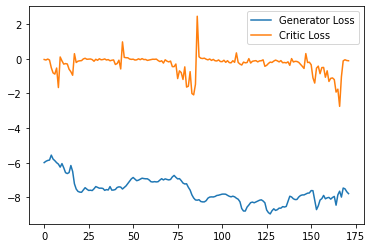

Step 3500: Generator loss: -7.736083383560181, critic loss: -0.10460992276668547


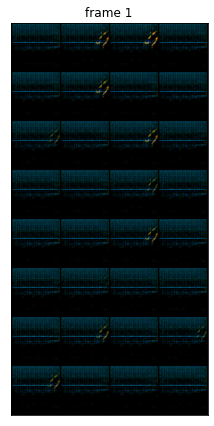

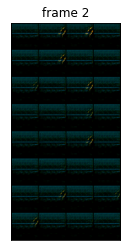

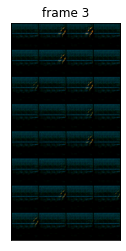

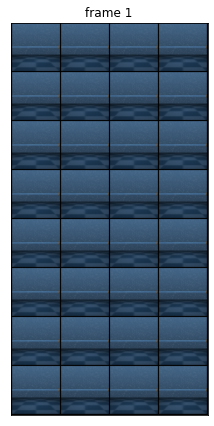

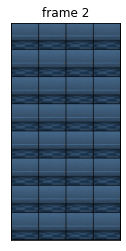

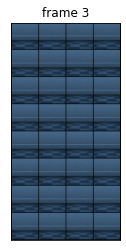

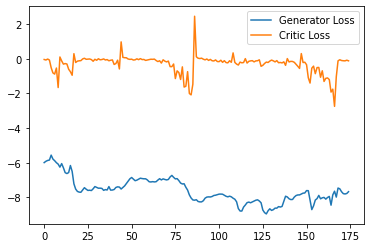

Step 3550: Generator loss: -7.57239294052124, critic loss: -0.10793077480793002


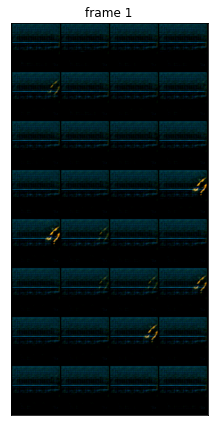

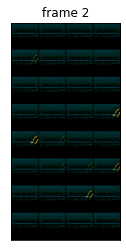

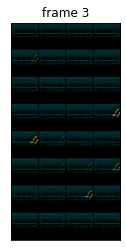

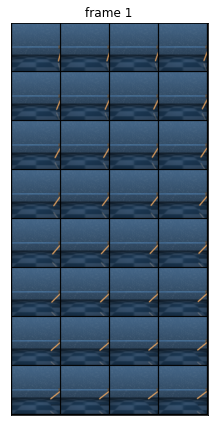

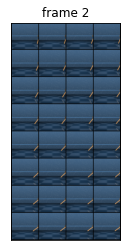

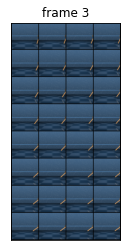

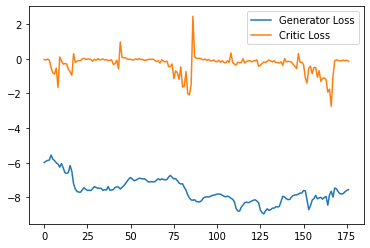

Step 3600: Generator loss: -7.614390869140625, critic loss: -0.11858762278407813


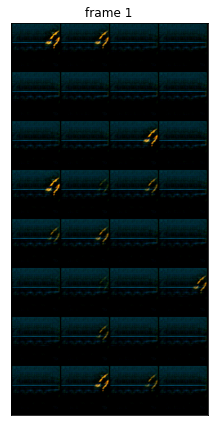

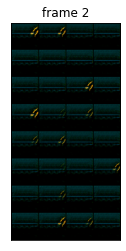

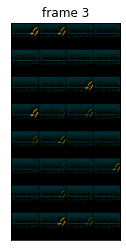

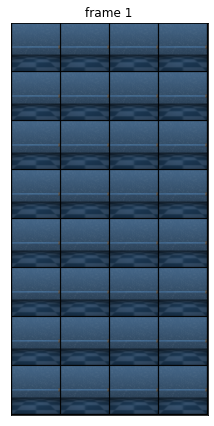

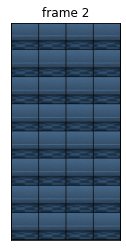

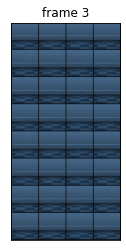

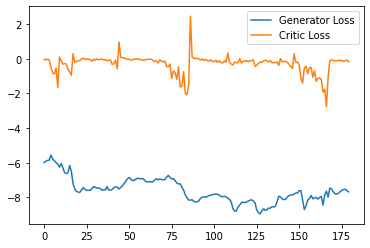

Step 3650: Generator loss: -7.603399038314819, critic loss: -0.08921823339909313


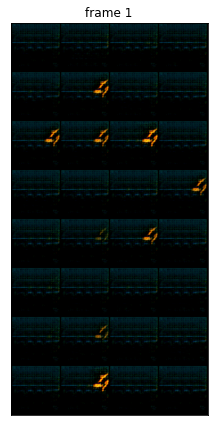

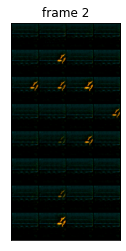

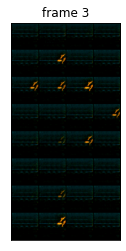

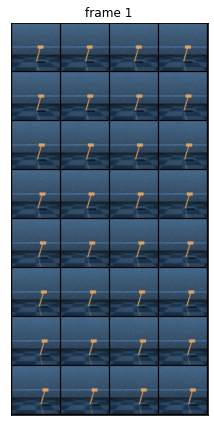

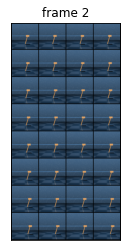

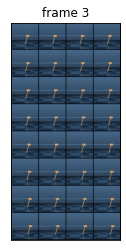

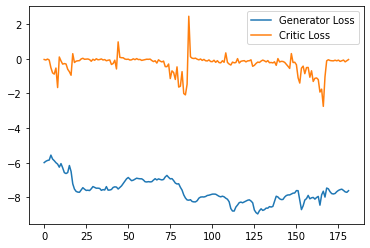

Step 3700: Generator loss: -7.6387631225585935, critic loss: -0.40386901596188546


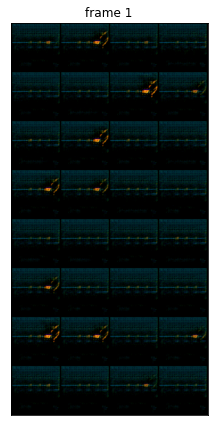

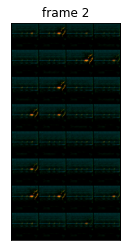

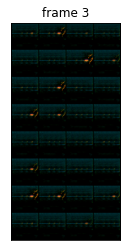

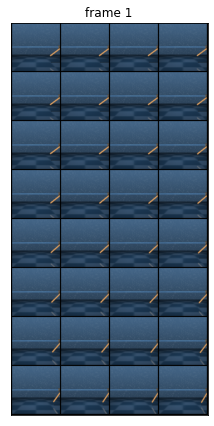

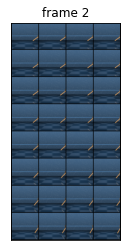

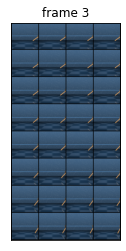

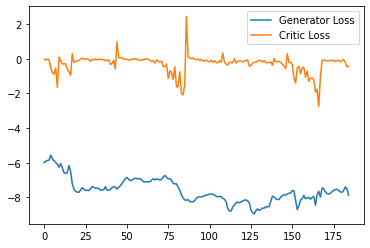

Step 3750: Generator loss: -8.304542007446289, critic loss: -0.7197774588018655


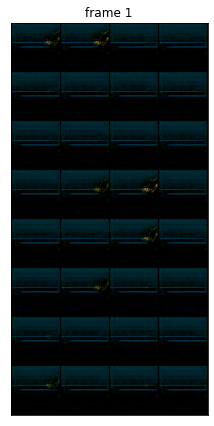

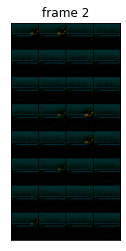

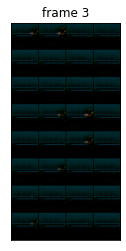

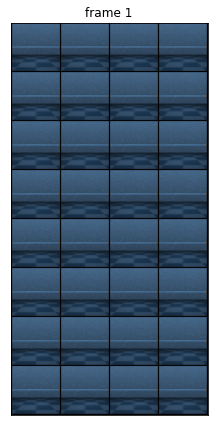

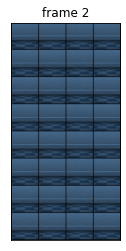

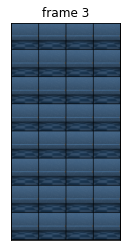

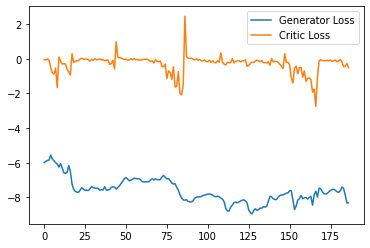

Step 3800: Generator loss: -8.046498079299926, critic loss: -0.7274943169057368


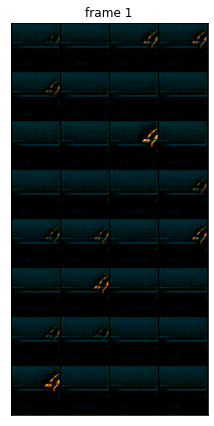

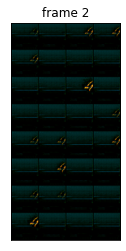

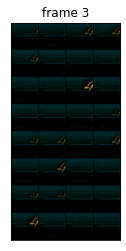

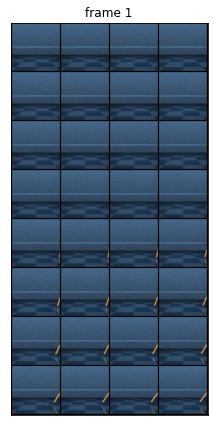

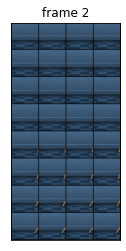

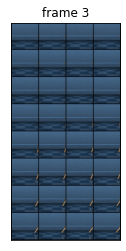

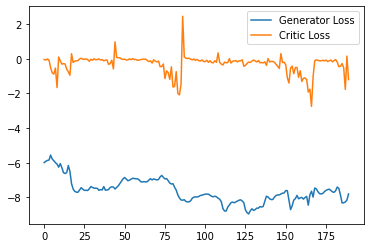

Step 3850: Generator loss: -7.9588784503936765, critic loss: -0.6278075952008366


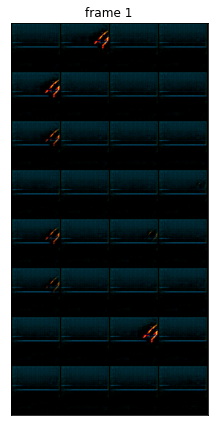

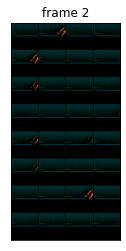

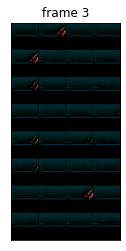

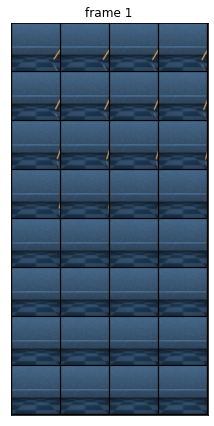

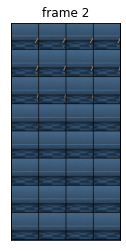

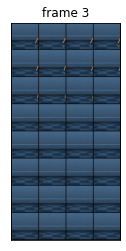

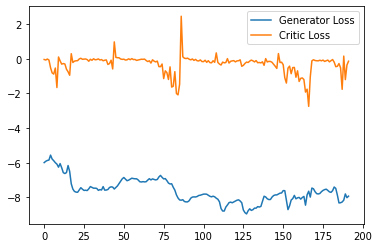

Step 3900: Generator loss: -8.067040119171143, critic loss: 0.13036091907322417


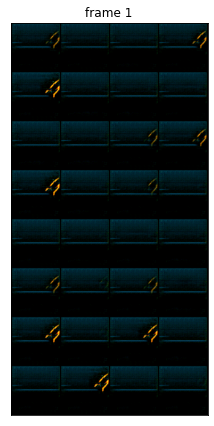

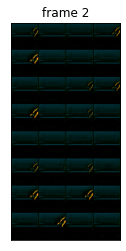

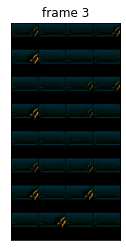

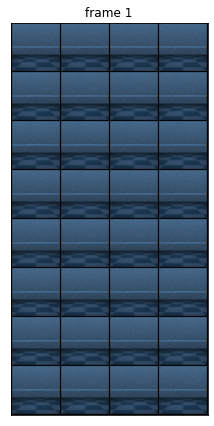

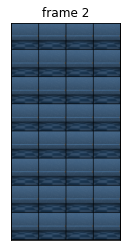

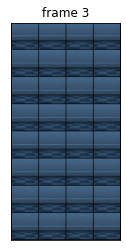

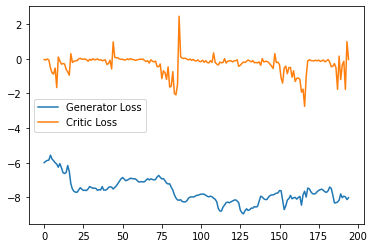

Step 3950: Generator loss: -8.0564235496521, critic loss: -0.07225340656377376


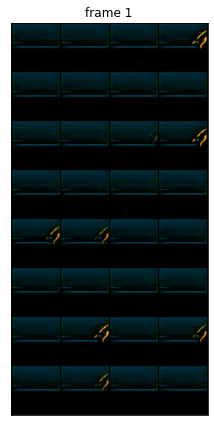

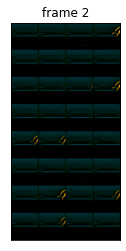

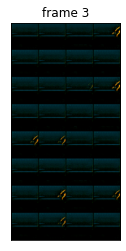

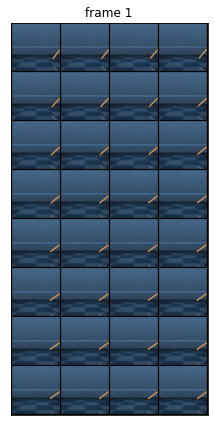

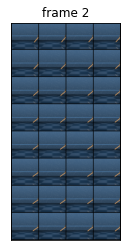

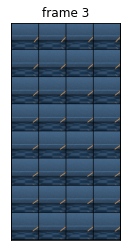

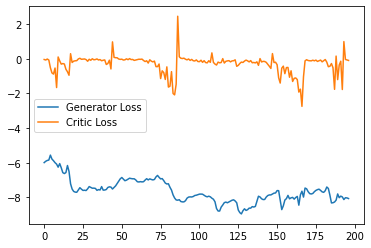

Step 4000: Generator loss: -8.072122859954835, critic loss: -0.030968299461528653


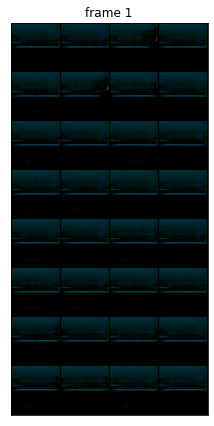

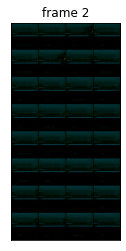

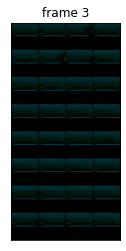

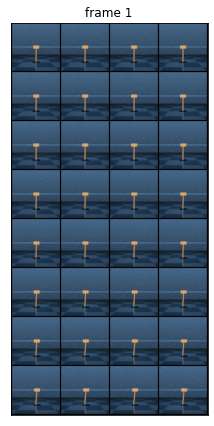

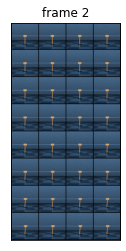

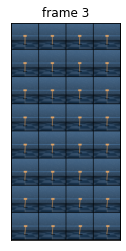

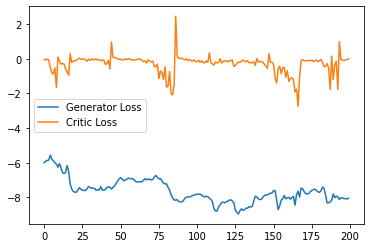

Step 4050: Generator loss: -7.909044275283813, critic loss: -0.09020943258330226


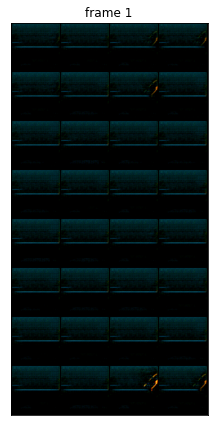

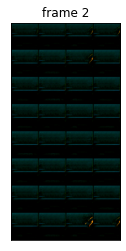

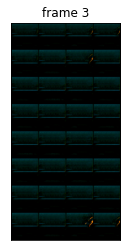

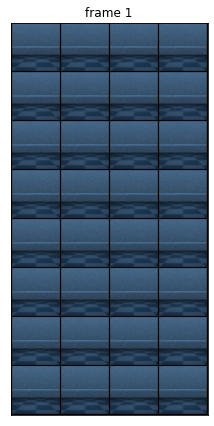

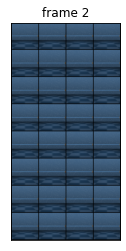

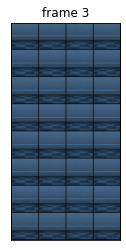

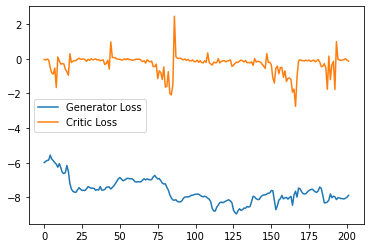

Step 4100: Generator loss: -7.855693225860596, critic loss: -0.1260668648025021


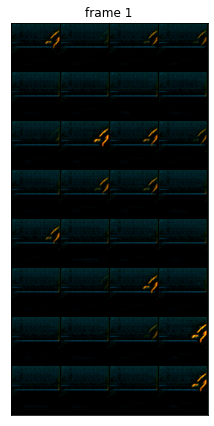

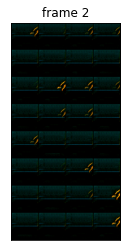

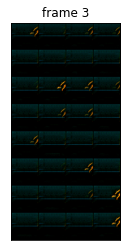

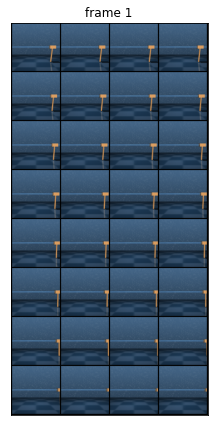

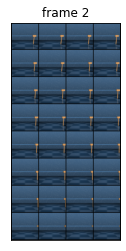

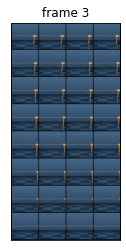

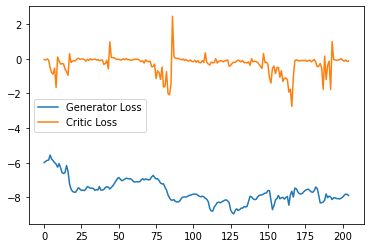

Step 4150: Generator loss: -7.822309103012085, critic loss: -0.16664992180466653


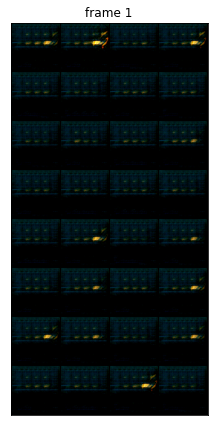

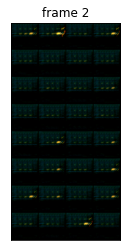

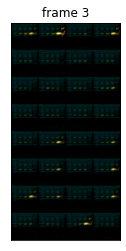

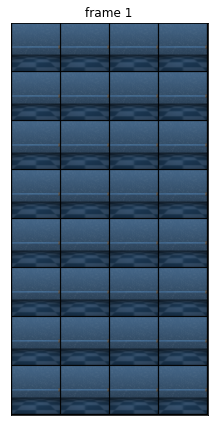

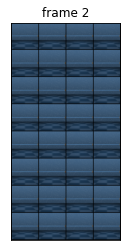

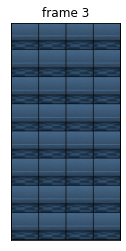

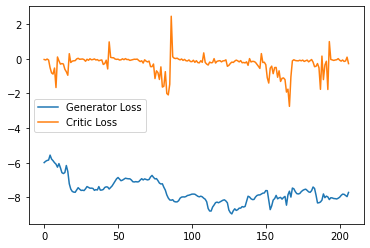

Step 4200: Generator loss: -8.219129600524901, critic loss: -0.3052606392987073


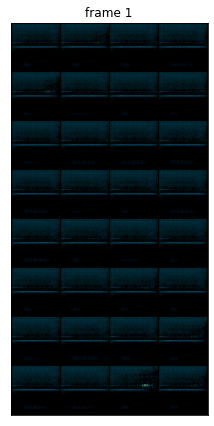

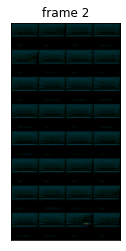

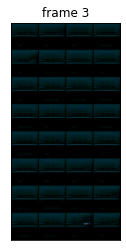

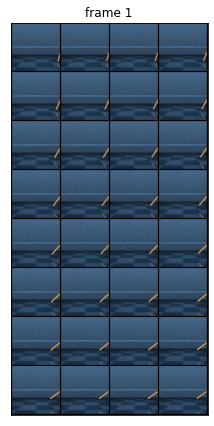

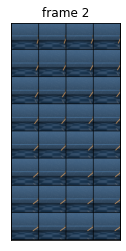

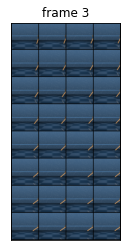

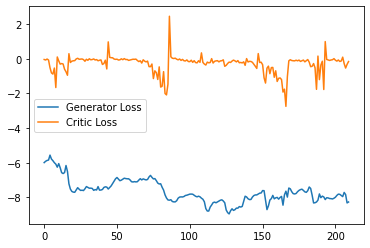

Step 4250: Generator loss: -8.344444694519042, critic loss: -0.832233099259436


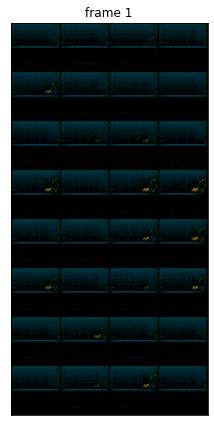

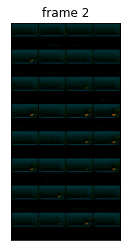

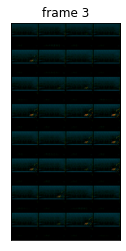

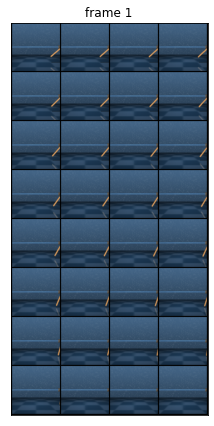

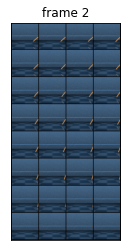

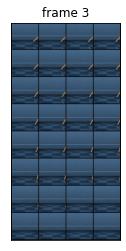

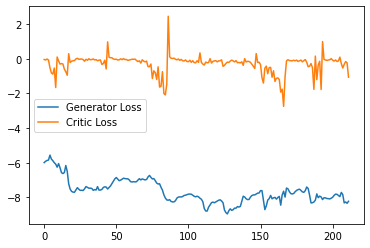

Step 4300: Generator loss: -8.358626146316528, critic loss: -0.5865435044243931


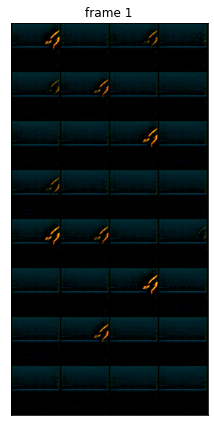

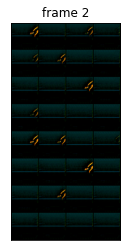

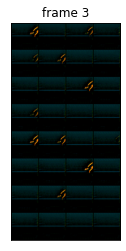

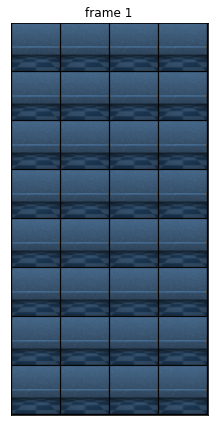

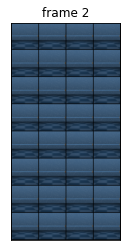

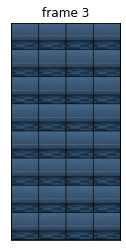

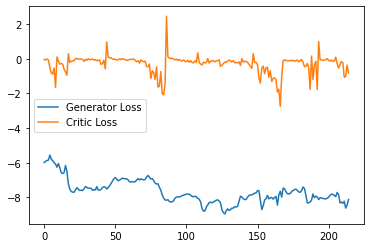

Step 4350: Generator loss: -8.577207975387573, critic loss: -0.08158072884660218


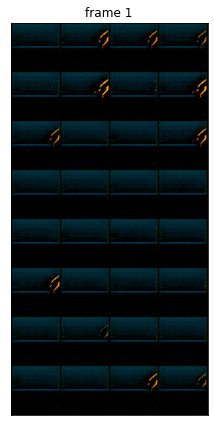

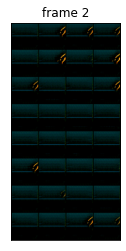

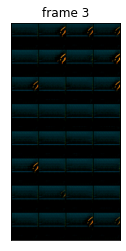

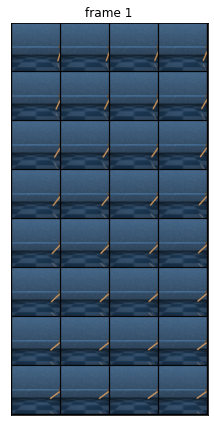

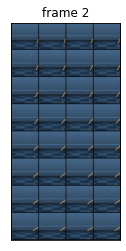

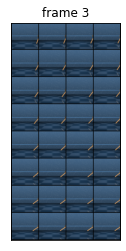

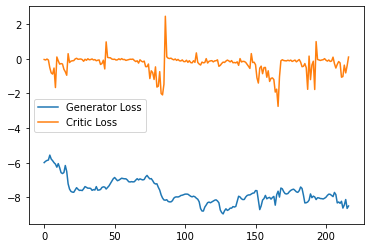

Step 4400: Generator loss: -8.363579406738282, critic loss: -0.0691014782115817


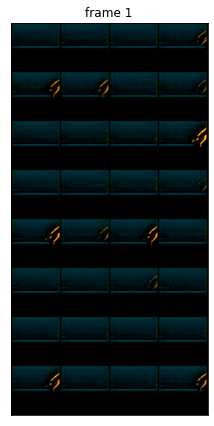

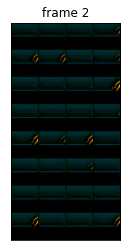

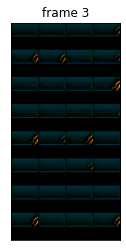

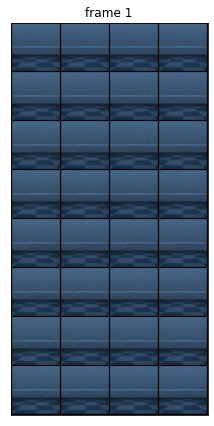

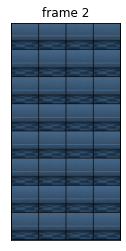

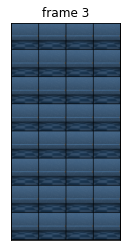

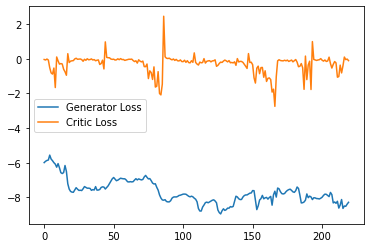

Step 4450: Generator loss: -8.27368091583252, critic loss: -0.1958345932029188


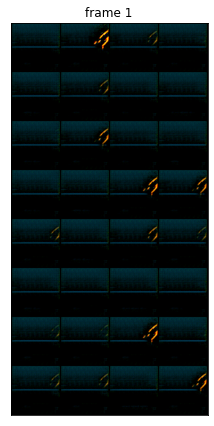

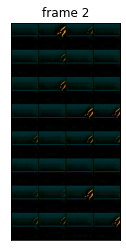

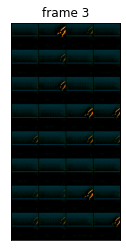

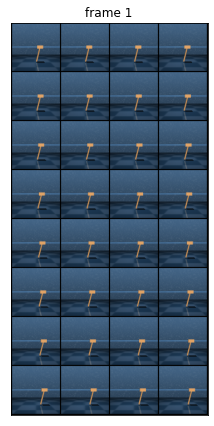

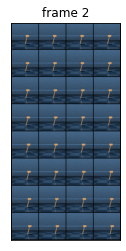

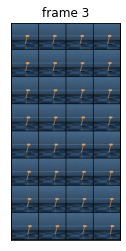

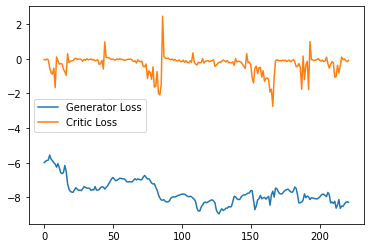

Step 4500: Generator loss: -8.172227439880372, critic loss: -0.42330863320082424


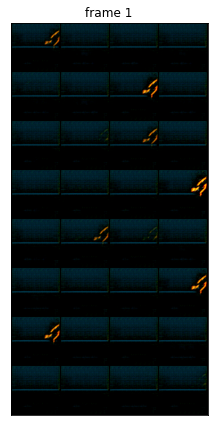

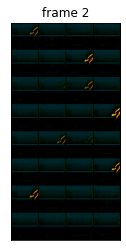

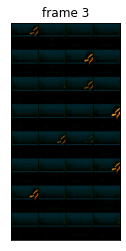

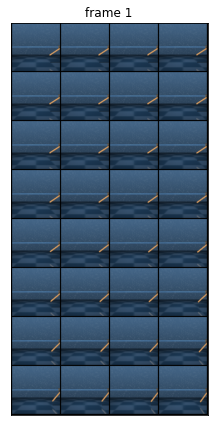

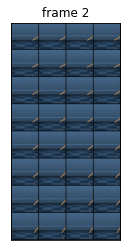

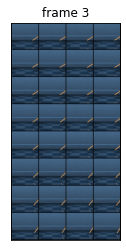

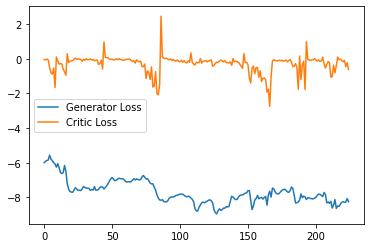

Step 4550: Generator loss: -8.260048789978027, critic loss: -2.160177844069898


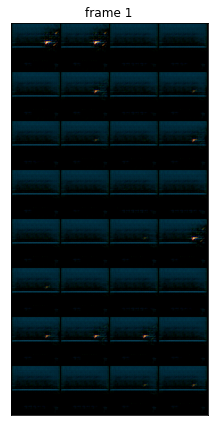

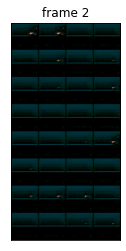

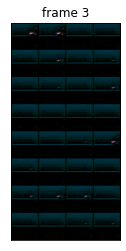

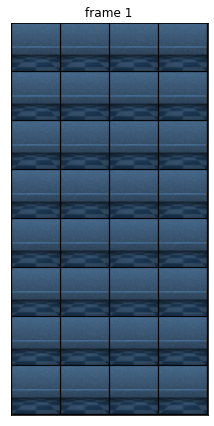

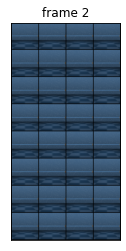

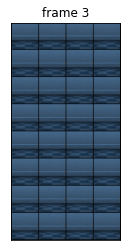

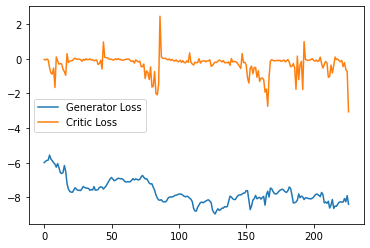

Step 4600: Generator loss: -9.028313522338868, critic loss: -2.472762104153633


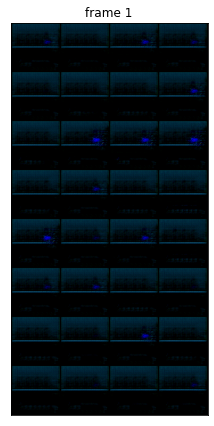

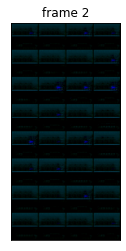

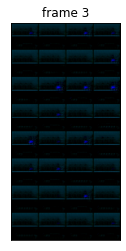

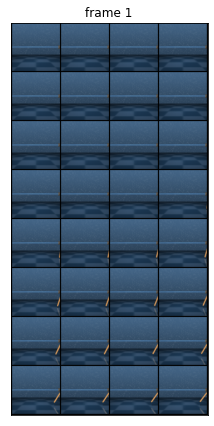

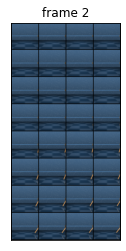

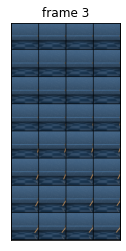

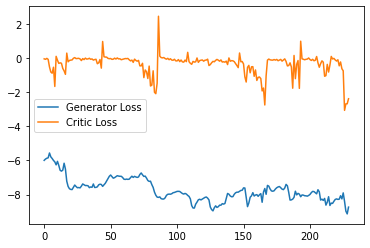

Step 4650: Generator loss: -9.955944309234619, critic loss: -1.9355163572579621


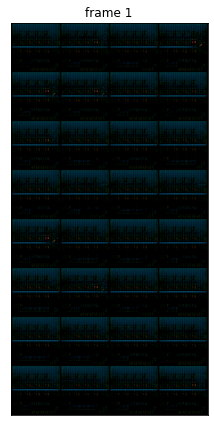

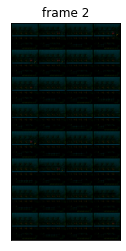

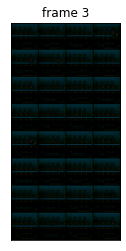

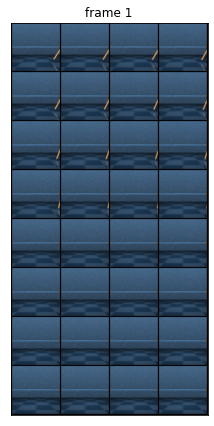

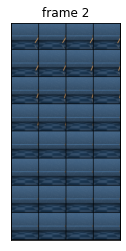

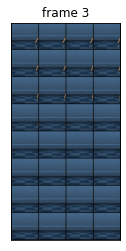

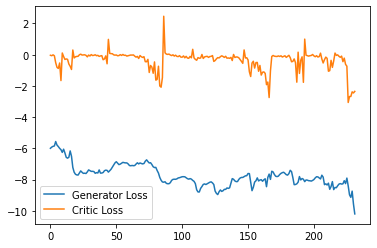

Step 4700: Generator loss: -9.935033740997314, critic loss: -0.2760223379433155


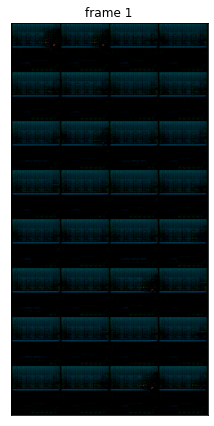

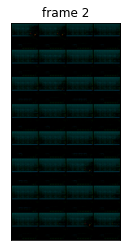

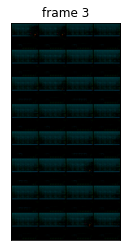

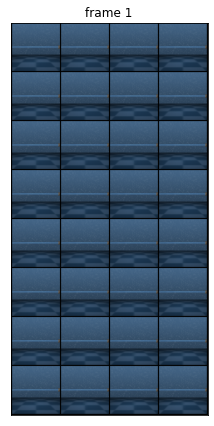

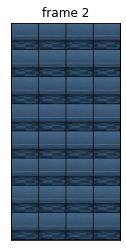

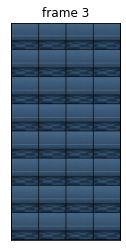

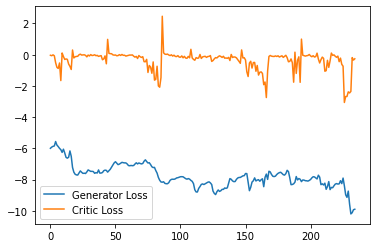

Step 4750: Generator loss: -9.853544368743897, critic loss: 0.02215111639350651


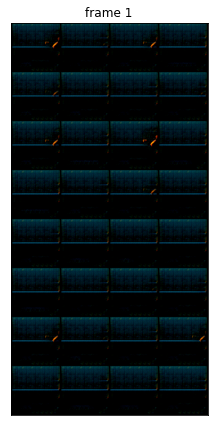

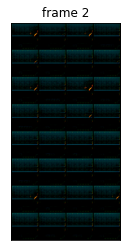

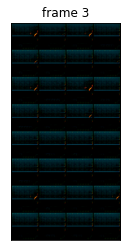

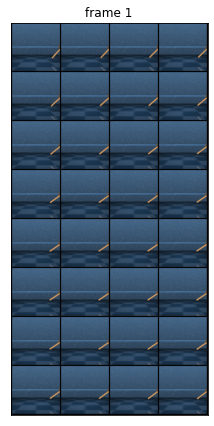

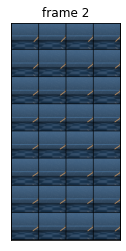

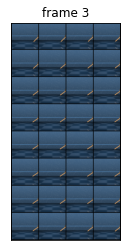

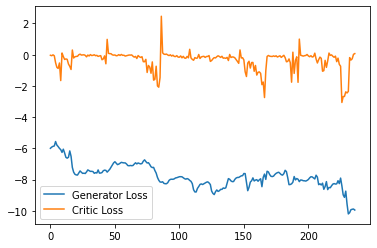

Step 4800: Generator loss: -9.634540767669678, critic loss: -0.11109508304670455


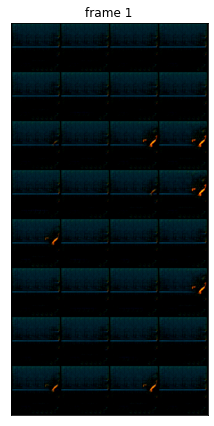

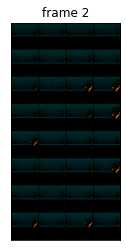

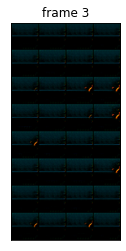

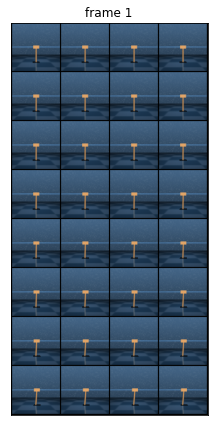

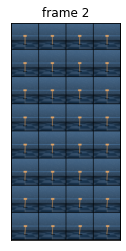

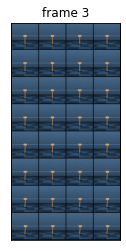

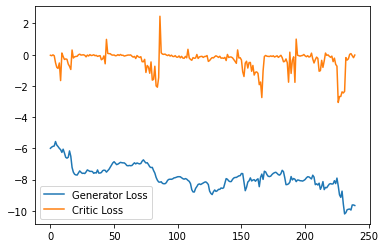

Step 4850: Generator loss: -9.810499954223634, critic loss: 0.0097228611074388


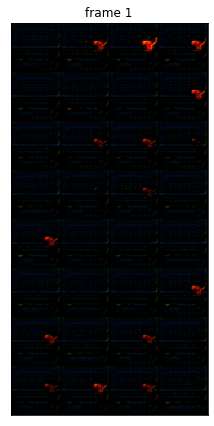

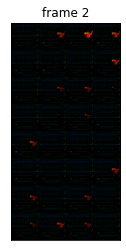

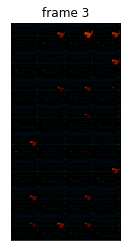

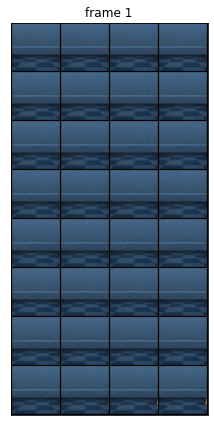

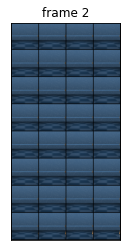

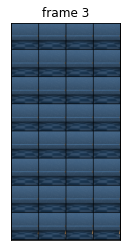

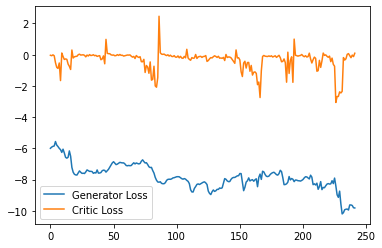

Step 4900: Generator loss: -10.164539585113525, critic loss: -0.23169120395183565


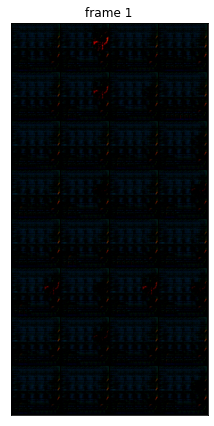

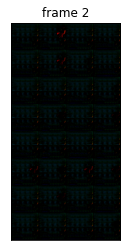

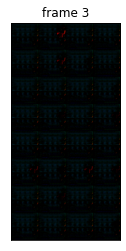

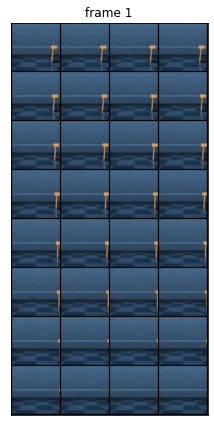

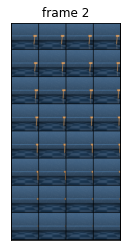

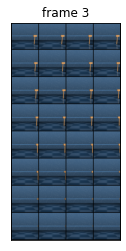

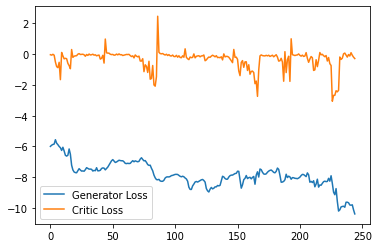

Step 4950: Generator loss: -10.421508102416992, critic loss: -0.12743798367679124


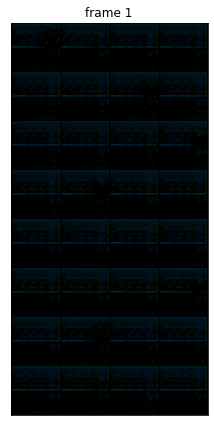

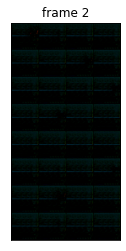

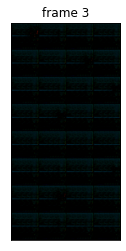

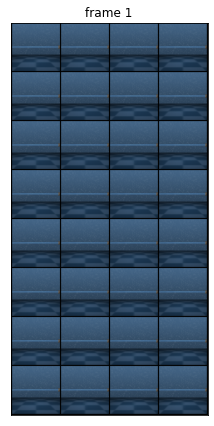

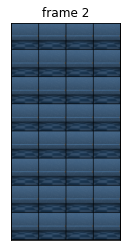

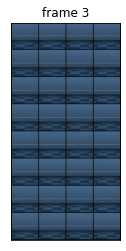

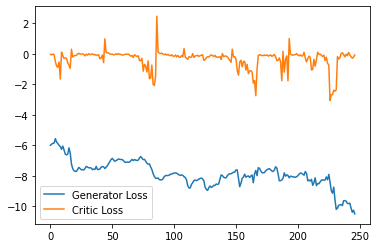

Step 5000: Generator loss: -10.626661567687988, critic loss: -0.047749511703848835


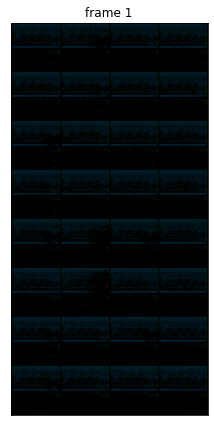

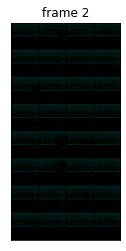

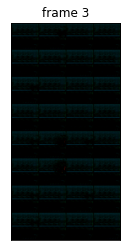

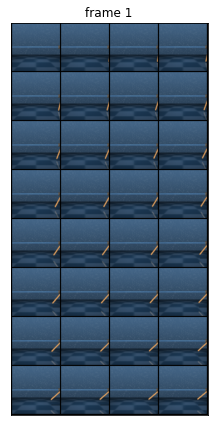

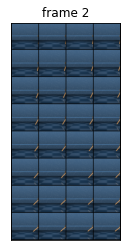

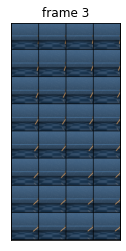

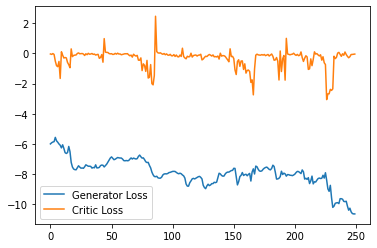

Step 5050: Generator loss: -10.530932445526123, critic loss: -0.03796864057146013


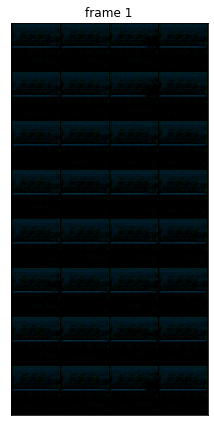

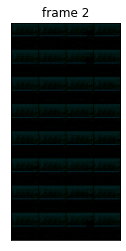

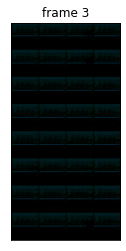

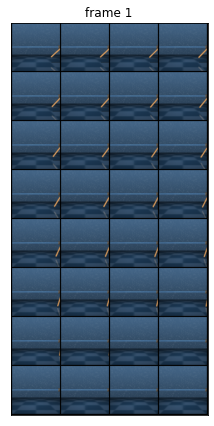

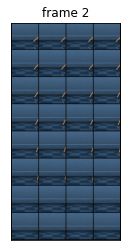

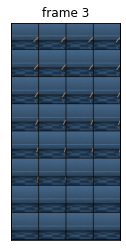

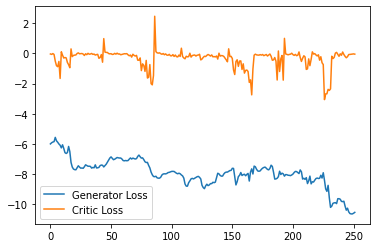

Step 5100: Generator loss: -10.297752475738525, critic loss: -0.0638628524336964


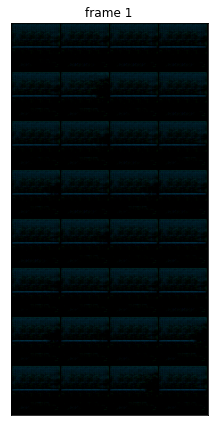

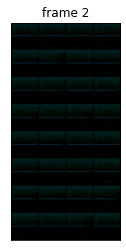

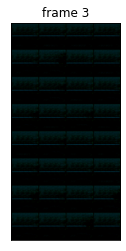

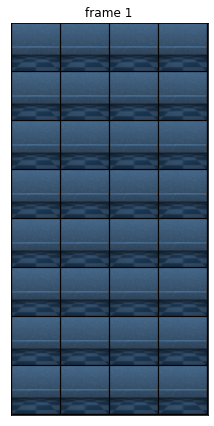

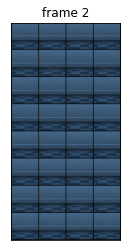

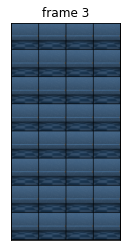

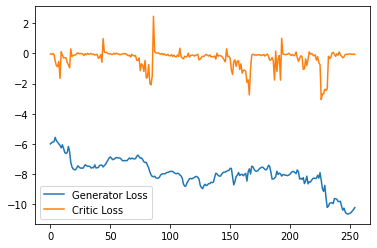

Step 5150: Generator loss: -10.19068510055542, critic loss: -0.12550529802218083


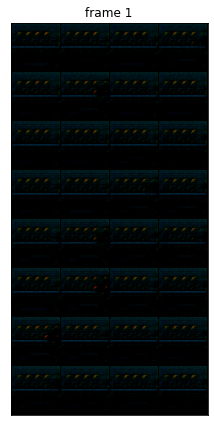

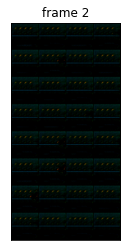

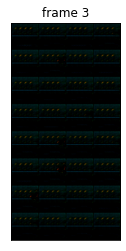

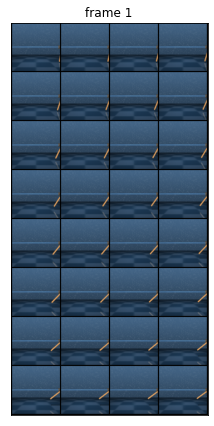

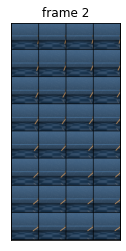

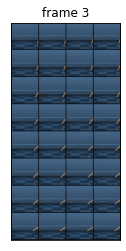

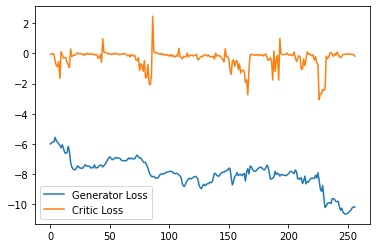

Step 5200: Generator loss: -10.230467681884766, critic loss: -0.029023800395429136


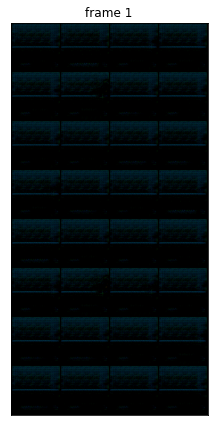

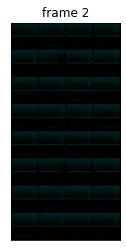

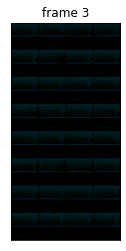

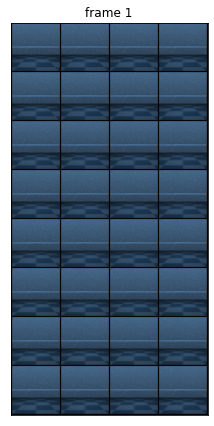

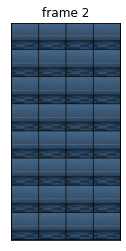

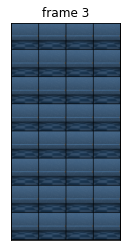

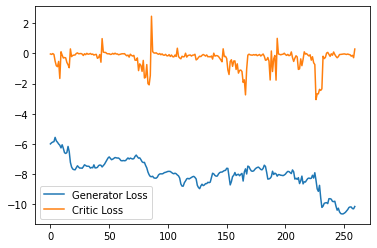

Step 5250: Generator loss: -10.262693920135497, critic loss: -0.10392292432300748


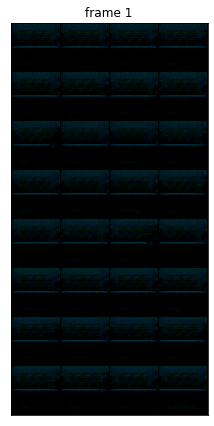

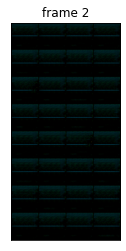

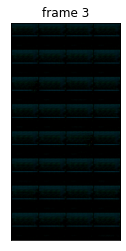

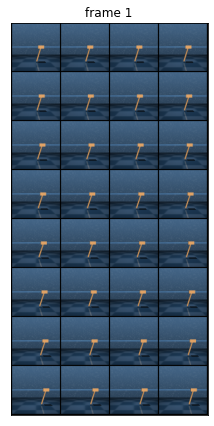

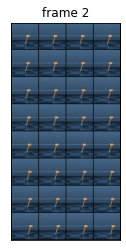

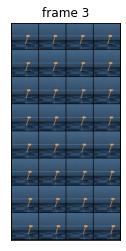

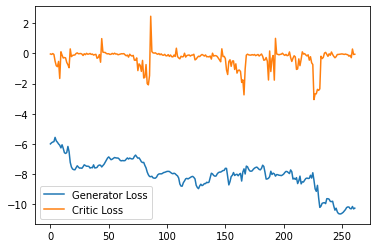

Step 5300: Generator loss: -10.123510971069337, critic loss: -0.20737706943042578


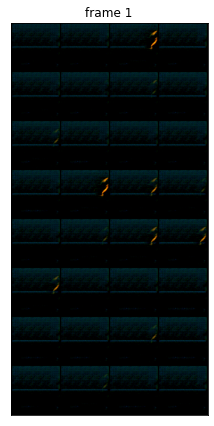

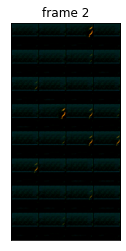

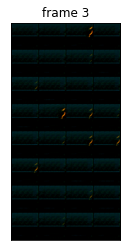

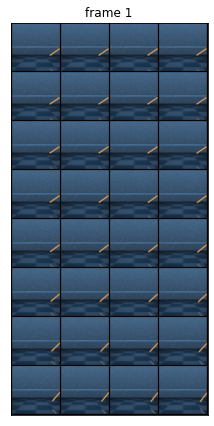

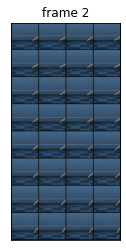

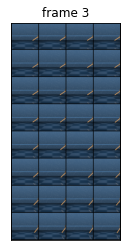

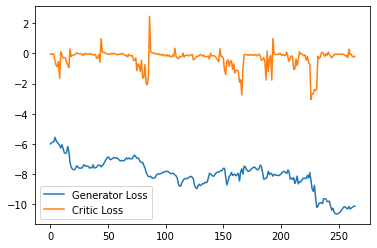

Step 5350: Generator loss: -10.098509216308594, critic loss: -0.31211818964779386


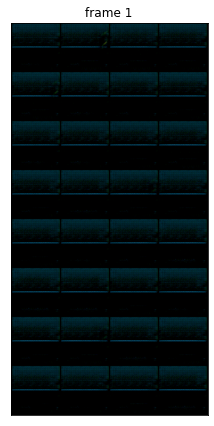

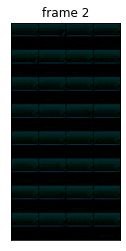

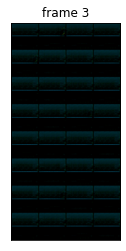

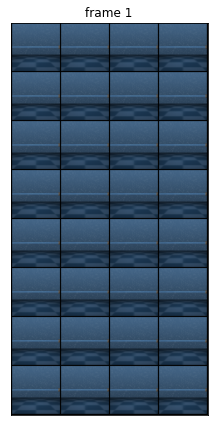

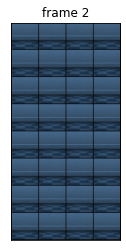

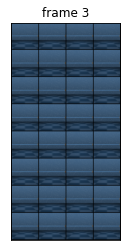

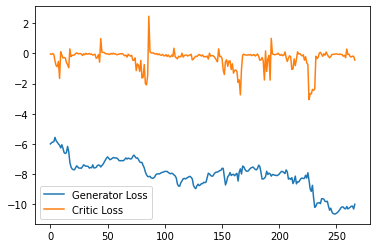

Step 5400: Generator loss: -9.83188024520874, critic loss: -0.4098057923074812


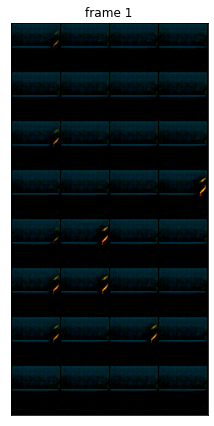

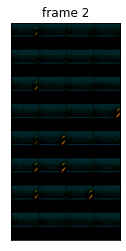

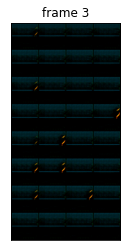

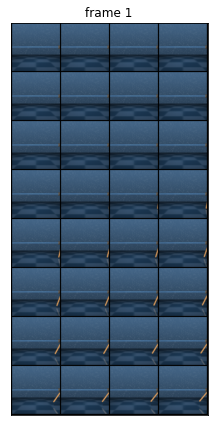

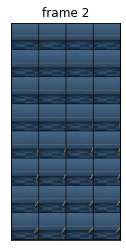

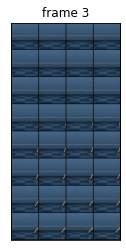

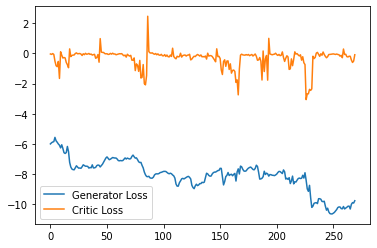

In [ ]:
import matplotlib.pyplot as plt
import glob
args['model_gen_dir'] = 'gan_gen'
args['model_disc_dir'] = 'gan_disc'
model_gen_dir = utils.make_dir(os.path.join(args['work_dir'], args['model_gen_dir']))
model_disc_dir = utils.make_dir(os.path.join(args['work_dir'], args['model_disc_dir']))
cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    ####################################################################################
    # make sure to change the directory name in the following glob()
    ####################################################################################
    for buffer in glob.glob("./tmp/cartpole-swingup-11-12-im84-b32-s1-pixel/buffer/*.pt"):
        buf = torch.load(buffer)
        replay_buffer = buf[0]
        no_of_batches = int(replay_buffer.shape[0]/batch_size)
        for i in range(0, no_of_batches+1):
            if(i!=no_of_batches):
                real = torch.tensor(replay_buffer[i*batch_size:(i+1)*batch_size, :, :, :]/255.).float()
            else:
                real = torch.tensor(replay_buffer[i*batch_size:, :, :, :]/255.).float()
            cur_batch_size = len(real)
            real = real.to(device)
            mean_iteration_critic_loss = 0
            for _ in range(crit_repeats):
                crit_opt.zero_grad()
                fake_noise = get_noise(cur_batch_size, z_dim, device=device)
                fake = gen(fake_noise)
                crit_fake_pred = crit(fake.detach())
                crit_real_pred = crit(real)

                epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
                gradient = get_gradient(crit, real, fake.detach(), epsilon)
                gp = gradient_penalty(gradient)
                crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

                # Keep track of the average critic loss in this batch
                mean_iteration_critic_loss += crit_loss.item() / crit_repeats
                # Update gradients
                crit_loss.backward(retain_graph=True)
                # Update optimizer
                crit_opt.step()
            critic_losses += [mean_iteration_critic_loss]

            ### Update generator ###
            gen_opt.zero_grad()
            fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
            fake_2 = gen(fake_noise_2)
            crit_fake_pred = crit(fake_2)

            gen_loss = get_gen_loss(crit_fake_pred)
            gen_loss.backward()

            # Update the weights
            gen_opt.step()

            # Keep track of the average generator loss
            generator_losses += [gen_loss.item()]

            ### Visualization code ###
            if cur_step % display_step == 0 and cur_step > 0:
                gen_mean = sum(generator_losses[-display_step:]) / display_step
                crit_mean = sum(critic_losses[-display_step:]) / display_step
                print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
                show_stacked_imgs(fake.cpu().data.numpy())
                show_stacked_imgs(real.cpu().data.numpy())
                step_bins = 20
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Critic Loss"
                )
                plt.legend()
                plt.show()
            cur_step += 1
    torch.save(gen.state_dict(), '%s/%s.pt' % (model_gen_dir, cur_step))
    torch.save(crit.state_dict(), '%s/%s.pt' % (model_disc_dir, cur_step))